# Session (475165_f3_stage2_day12)

# Processing of Raw Calcium Cortical Data into dFF tiff Stacks

In [1]:
"""install the packages to run this code"""
#%pip install matplotlib tifffile scipy tqdm pybaselines opencv-python imagecodecs pickle #plotly #need to do this through conda install

'install the packages to run this code'

In [2]:
session = "475165_f3_stage2_day12" #cageID_mouseID_stage_day

## Step 1: importing the proper libraries

note: all packaged are compatible with Python 3.12 as of 2024, Feb 22

In [3]:
import numpy as np
import matplotlib.pyplot as plt
import tifffile
import cv2
from scipy import interpolate
from scipy.interpolate import interp1d
from scipy.ndimage import gaussian_filter
from scipy.signal import cheby1, filtfilt, find_peaks, peak_widths
import scipy
from tqdm import tqdm
%matplotlib inline
import plotly.express as px
import imagecodecs
from matplotlib.animation import FuncAnimation
import pickle
from pybaselines import Baseline
import pandas as pd
from ipywidgets import interact, FloatSlider
import matplotlib.gridspec as gridspec

from preprocessing_functions import (load_frames, 
                                        interactive_plot, 
                                        plot_frame, 
                                        temporal_mean, 
                                        remove_dark_frames, 
                                        extract_artifacts, 
                                        interpolate, 
                                        dff, 
                                        smoothing, 
                                        save_tiff,
                                        load_txt,
                                        extract_txt_flashes,
                                        load_masks, 
                                        avg_trials,
                                        extract_v1,
                                        animate_figure, 
extract_success,
sort_success,
extract_nogo)

## Step 2: importing and exporting from the script

### 2A: Manual importing data and paths

Please insert the file path for the tif stack as a 3d array

In [4]:
missing_artifacts = "FALSE"

In [5]:
cohort = "3_third_cohort"

### 2B: Manual Exporting data path

In [6]:
parts = session.split("_") # Split the string by underscores

cageID_mouseID = f"{parts[0]}_{parts[1]}" #cageID_mouseID
cageID, mouseID = parts[0], parts[1] #newv2
day = parts[3]  # what day of the stage they are in

print(f"cageID_mouseID = \"{cageID_mouseID}\"")
print(f"day = \"{day}\"")

cageID_mouseID = "475165_f3"
day = "day12"


### 2C: autonomous loadings and exporting lines !do not need to manipulate!

#### 2C.1: loading frames in

In [7]:
common_cortical_path = "X:/RaymondLab/1_Kai/1_cortical_data/"

In [8]:
video = f"{common_cortical_path}/{cohort}/stage2/{session}.tif"

In [9]:
frame_number = 6000 #please insert frame number to view
frames = load_frames(video); #loading in tif stack, this will take a little while

loading video, please wait...


dimensions are (39978, 128, 128) as a uint16


#### 2C.2: Tiff stack (spatial view videos) export

make sure folders exists: files are organized by common_tiff_path -> stage -> day -> full,single,double -> File_name(cage_mouseid_stage_day_condition)

In [10]:
common_tiff_path = "X:/RaymondLab/1_Kai/3_processed_data/1_tiff_stacks/stage2/"

In [11]:
tiff_path_full = f"{common_tiff_path}{day}/full_frame/{cageID_mouseID}_stage2_{day}_full_frame.tiff"
tiff_path_single = f"{common_tiff_path}{day}/single/{cageID_mouseID}_stage2_{day}_single.tiff"
tiff_path_double = f"{common_tiff_path}{day}/double/{cageID_mouseID}_stage2_{day}_double.tiff"

#### 2C.3: Pickle export timeseries array

make sure folders exist: files are organized by common_pickle_path -> stage -> day -> single,double -> ROI -> File_name(cage_mouseid_stage_day_condition)

In [12]:
common_pickle_path = "X:/RaymondLab/1_Kai/3_processed_data/2_pickle/stage2/"

In [13]:
pickle_single_v1 = f"{common_pickle_path}{day}/single/v1/{cageID_mouseID}_stage2_{day}_single_v1.pickle"
pickle_double_v1 = f"{common_pickle_path}{day}/double/v1/{cageID_mouseID}_stage2_{day}_double_v1.pickle"

pickle_single_success_ff = f"{common_pickle_path}single/success/full_frame/{cageID_mouseID}_stage2_{day}_single_success_ff.pickle"
pickle_double_success_ff = f"{common_pickle_path}double/success/full_frame/{cageID_mouseID}_stage2_{day}_double_success_ff.pickle"
pickle_nogo_success_ff = f"{common_pickle_path}nogo/success/full_frame/{cageID_mouseID}_stage2_{day}_nogo_success_ff.pickle"

pickle_single_fail_ff = f"{common_pickle_path}single/fail/full_frame/{cageID_mouseID}_stage2_{day}_single_fail_ff.pickle"
pickle_double_fail_ff = f"{common_pickle_path}double/fail/full_frame/{cageID_mouseID}_stage2_{day}_double_fail_ff.pickle"
pickle_nogo_fail_ff = f"{common_pickle_path}nogo/fail/full_frame/{cageID_mouseID}_stage2_{day}_nogo_fail_ff.pickle"

## Step 3: Plot of Raw Frames and Timecourse

### 3A: Plotting raw frame example, to make sure the tif stack loaded in properly.


Make sure the frames are a 3d array, two figures will be generated, a greyscaled and colormapped. They are technically identical

frame number 6000 plotted


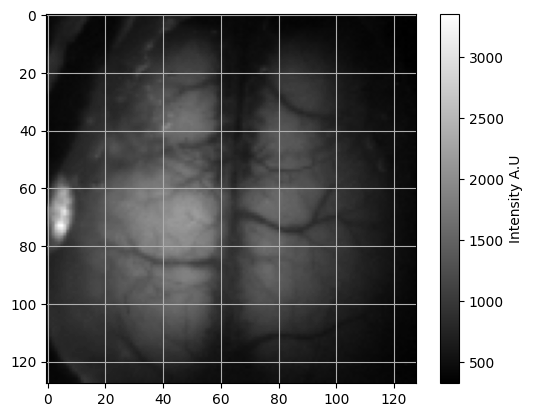

frame number 6000 plotted


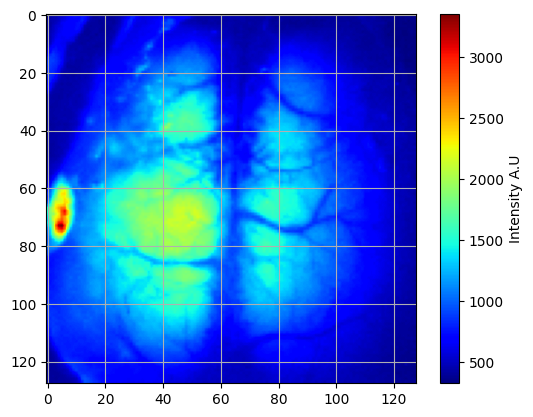

In [14]:
plot_frame(frames, frame_number, cmap = 'grey', color_label = "Intensity A.U")
plot_frame(frames, frame_number, cmap = 'jet', color_label = "Intensity A.U")

### 3B: Plot of the raw signal mean for each frame over the length of the experiment

Mean time course of the raw signal

In [15]:
mean_timecourse = temporal_mean(frames);

default 20% threshold is 336.8162841796875 Determine if adjustments need to be made


## Step 4: Mean Timecourse without Darkframes at Start and End

#### 4A: plot of timecourse

#### 4B: number of single and double flashes as well as total number.

In [16]:
darkf_removed = remove_dark_frames(frames, mean_timecourse, 0.35)
darkf_removed_timecourse, darkf_removed_frames = darkf_removed[0], darkf_removed[1] #first one is the timecourse with no 3d, second is the 3d array

threshold determined to be: 378.91831970214844


#### 4C: pybaselines (only run if missing flashes)

In [17]:
if missing_artifacts == "TRUE":
    x = np.linspace(0, len(darkf_removed_timecourse), len(darkf_removed_timecourse))
    baseline_fitter = Baseline(x_data=x)

    smoothed_imodpoly = baseline_fitter.imodpoly(darkf_removed_timecourse, poly_order=3, num_std=0.7)[0]
    flattened = darkf_removed_timecourse-smoothed_imodpoly

    artifacts = extract_artifacts(flattened)
    artifact_indices, single_indices, double_indices = artifacts[0], artifacts[1], artifacts[2]

    #plotting moving mean and signal
    fig = px.line(y = [flattened])
    fig.update_layout(
    title= "mean timecourse with moving average overlay",
    xaxis=dict(title="frame number (30 fps)"),
    yaxis=dict(title="intensity value (A.U)"),
    xaxis_rangeslider_visible=True,
    showlegend=True)

    fig.for_each_trace(lambda t: t.update(name="Signal") if "0" in t.name else t.update(name="10s Moving Average"))

    fig.show()

    plt.figure()
    plt.plot(darkf_removed_timecourse, label='Subset Signal')
    plt.plot(smoothed_imodpoly, '--', label='Smoothed imodpoly')
    plt.legend()
    plt.show()

!! If the total does not match the single and double combined, check dataset!!

In [18]:
if missing_artifacts == "FALSE": #newv2
    artifacts = extract_artifacts(darkf_removed_timecourse)
    artifact_indices, single_indices, double_indices = artifacts[0], artifacts[1], artifacts[2]

Number of double_flash: 80
Number of double_flash pairs: 40
Number of single_flash: 42
Number of total flashes: 122


## Step 5: Artifact Removal and DFF

### 5A: Plot of mean timecourse with artifacts removed


plot is generated with interpolated frames where the artifacts were, approximately 5 frames

In [19]:
no_artifact_timecourse = interpolate(darkf_removed_frames, artifact_indices, 5)

interpolating artifact frames...


  0%|                                                                                          | 0/122 [00:00<?, ?it/s]

  1%|▋                                                                                 | 1/122 [00:01<02:42,  1.34s/it]

  2%|█▎                                                                                | 2/122 [00:02<02:38,  1.32s/it]

  2%|██                                                                                | 3/122 [00:03<02:38,  1.33s/it]

  3%|██▋                                                                               | 4/122 [00:05<02:34,  1.31s/it]

  4%|███▎                                                                              | 5/122 [00:06<02:30,  1.28s/it]

  5%|████                                                                              | 6/122 [00:07<02:28,  1.28s/it]

  6%|████▋                                                                             | 7/122 [00:09<02:26,  1.28s/it]

  7%|█████▍                                                                            | 8/122 [00:10<02:24,  1.27s/it]

  7%|██████                                                                            | 9/122 [00:11<02:24,  1.28s/it]

  8%|██████▋                                                                          | 10/122 [00:13<02:29,  1.34s/it]

  9%|███████▎                                                                         | 11/122 [00:14<02:24,  1.31s/it]

 10%|███████▉                                                                         | 12/122 [00:15<02:17,  1.25s/it]

 11%|████████▋                                                                        | 13/122 [00:16<02:16,  1.25s/it]

 11%|█████████▎                                                                       | 14/122 [00:17<02:14,  1.24s/it]

 12%|█████████▉                                                                       | 15/122 [00:19<02:15,  1.26s/it]

 13%|██████████▌                                                                      | 16/122 [00:20<02:14,  1.26s/it]

 14%|███████████▎                                                                     | 17/122 [00:21<02:11,  1.25s/it]

 15%|███████████▉                                                                     | 18/122 [00:22<02:08,  1.24s/it]

 16%|████████████▌                                                                    | 19/122 [00:24<02:10,  1.27s/it]

 16%|█████████████▎                                                                   | 20/122 [00:25<02:13,  1.31s/it]

 17%|█████████████▉                                                                   | 21/122 [00:26<02:07,  1.26s/it]

 18%|██████████████▌                                                                  | 22/122 [00:28<02:06,  1.26s/it]

 19%|███████████████▎                                                                 | 23/122 [00:29<02:06,  1.27s/it]

 20%|███████████████▉                                                                 | 24/122 [00:30<02:02,  1.25s/it]

 20%|████████████████▌                                                                | 25/122 [00:31<02:04,  1.28s/it]

 21%|█████████████████▎                                                               | 26/122 [00:33<02:07,  1.32s/it]

 22%|█████████████████▉                                                               | 27/122 [00:34<02:06,  1.34s/it]

 23%|██████████████████▌                                                              | 28/122 [00:36<02:07,  1.36s/it]

 24%|███████████████████▎                                                             | 29/122 [00:37<02:06,  1.36s/it]

 25%|███████████████████▉                                                             | 30/122 [00:38<02:04,  1.35s/it]

 25%|████████████████████▌                                                            | 31/122 [00:40<02:02,  1.35s/it]

 26%|█████████████████████▏                                                           | 32/122 [00:41<02:00,  1.34s/it]

 27%|█████████████████████▉                                                           | 33/122 [00:42<01:56,  1.31s/it]

 28%|██████████████████████▌                                                          | 34/122 [00:43<01:51,  1.27s/it]

 29%|███████████████████████▏                                                         | 35/122 [00:45<01:51,  1.28s/it]

 30%|███████████████████████▉                                                         | 36/122 [00:46<01:48,  1.27s/it]

 30%|████████████████████████▌                                                        | 37/122 [00:47<01:50,  1.30s/it]

 31%|█████████████████████████▏                                                       | 38/122 [00:49<01:48,  1.29s/it]

 32%|█████████████████████████▉                                                       | 39/122 [00:50<01:49,  1.32s/it]

 33%|██████████████████████████▌                                                      | 40/122 [00:51<01:48,  1.32s/it]

 34%|███████████████████████████▏                                                     | 41/122 [00:53<01:48,  1.33s/it]

 34%|███████████████████████████▉                                                     | 42/122 [00:54<01:47,  1.34s/it]

 35%|████████████████████████████▌                                                    | 43/122 [00:55<01:45,  1.33s/it]

 36%|█████████████████████████████▏                                                   | 44/122 [00:57<01:42,  1.32s/it]

 37%|█████████████████████████████▉                                                   | 45/122 [00:58<01:41,  1.32s/it]

 38%|██████████████████████████████▌                                                  | 46/122 [00:59<01:41,  1.34s/it]

 39%|███████████████████████████████▏                                                 | 47/122 [01:00<01:37,  1.29s/it]

 39%|███████████████████████████████▊                                                 | 48/122 [01:02<01:37,  1.31s/it]

 40%|████████████████████████████████▌                                                | 49/122 [01:03<01:34,  1.30s/it]

 41%|█████████████████████████████████▏                                               | 50/122 [01:04<01:33,  1.29s/it]

 42%|█████████████████████████████████▊                                               | 51/122 [01:06<01:34,  1.33s/it]

 43%|██████████████████████████████████▌                                              | 52/122 [01:07<01:32,  1.32s/it]

 43%|███████████████████████████████████▏                                             | 53/122 [01:08<01:27,  1.26s/it]

 44%|███████████████████████████████████▊                                             | 54/122 [01:10<01:28,  1.30s/it]

 45%|████████████████████████████████████▌                                            | 55/122 [01:11<01:25,  1.28s/it]

 46%|█████████████████████████████████████▏                                           | 56/122 [01:12<01:25,  1.30s/it]

 47%|█████████████████████████████████████▊                                           | 57/122 [01:14<01:25,  1.32s/it]

 48%|██████████████████████████████████████▌                                          | 58/122 [01:15<01:23,  1.31s/it]

 48%|███████████████████████████████████████▏                                         | 59/122 [01:16<01:20,  1.28s/it]

 49%|███████████████████████████████████████▊                                         | 60/122 [01:17<01:17,  1.25s/it]

 50%|████████████████████████████████████████▌                                        | 61/122 [01:18<01:15,  1.24s/it]

 51%|█████████████████████████████████████████▏                                       | 62/122 [01:20<01:16,  1.28s/it]

 52%|█████████████████████████████████████████▊                                       | 63/122 [01:21<01:15,  1.29s/it]

 52%|██████████████████████████████████████████▍                                      | 64/122 [01:22<01:15,  1.31s/it]

 53%|███████████████████████████████████████████▏                                     | 65/122 [01:24<01:13,  1.28s/it]

 54%|███████████████████████████████████████████▊                                     | 66/122 [01:25<01:13,  1.31s/it]

 55%|████████████████████████████████████████████▍                                    | 67/122 [01:26<01:12,  1.31s/it]

 56%|█████████████████████████████████████████████▏                                   | 68/122 [01:28<01:09,  1.29s/it]

 57%|█████████████████████████████████████████████▊                                   | 69/122 [01:29<01:07,  1.28s/it]

 57%|██████████████████████████████████████████████▍                                  | 70/122 [01:30<01:06,  1.28s/it]

 58%|███████████████████████████████████████████████▏                                 | 71/122 [01:31<01:03,  1.24s/it]

 59%|███████████████████████████████████████████████▊                                 | 72/122 [01:33<01:02,  1.25s/it]

 60%|████████████████████████████████████████████████▍                                | 73/122 [01:34<01:02,  1.28s/it]

 61%|█████████████████████████████████████████████████▏                               | 74/122 [01:35<01:02,  1.31s/it]

 61%|█████████████████████████████████████████████████▊                               | 75/122 [01:37<01:02,  1.32s/it]

 62%|██████████████████████████████████████████████████▍                              | 76/122 [01:38<01:00,  1.31s/it]

 63%|███████████████████████████████████████████████████                              | 77/122 [01:39<00:58,  1.30s/it]

 64%|███████████████████████████████████████████████████▊                             | 78/122 [01:41<00:58,  1.32s/it]

 65%|████████████████████████████████████████████████████▍                            | 79/122 [01:42<00:57,  1.33s/it]

 66%|█████████████████████████████████████████████████████                            | 80/122 [01:43<00:55,  1.32s/it]

 66%|█████████████████████████████████████████████████████▊                           | 81/122 [01:44<00:52,  1.27s/it]

 67%|██████████████████████████████████████████████████████▍                          | 82/122 [01:46<00:51,  1.29s/it]

 68%|███████████████████████████████████████████████████████                          | 83/122 [01:47<00:49,  1.28s/it]

 69%|███████████████████████████████████████████████████████▊                         | 84/122 [01:48<00:49,  1.29s/it]

 70%|████████████████████████████████████████████████████████▍                        | 85/122 [01:50<00:46,  1.26s/it]

 70%|█████████████████████████████████████████████████████████                        | 86/122 [01:51<00:45,  1.27s/it]

 71%|█████████████████████████████████████████████████████████▊                       | 87/122 [01:52<00:46,  1.32s/it]

 72%|██████████████████████████████████████████████████████████▍                      | 88/122 [01:54<00:45,  1.33s/it]

 73%|███████████████████████████████████████████████████████████                      | 89/122 [01:55<00:43,  1.32s/it]

 74%|███████████████████████████████████████████████████████████▊                     | 90/122 [01:56<00:42,  1.33s/it]

 75%|████████████████████████████████████████████████████████████▍                    | 91/122 [01:57<00:39,  1.29s/it]

 75%|█████████████████████████████████████████████████████████████                    | 92/122 [01:59<00:39,  1.31s/it]

 76%|█████████████████████████████████████████████████████████████▋                   | 93/122 [02:00<00:38,  1.33s/it]

 77%|██████████████████████████████████████████████████████████████▍                  | 94/122 [02:01<00:36,  1.32s/it]

 78%|███████████████████████████████████████████████████████████████                  | 95/122 [02:03<00:34,  1.29s/it]

 79%|███████████████████████████████████████████████████████████████▋                 | 96/122 [02:04<00:32,  1.25s/it]

 80%|████████████████████████████████████████████████████████████████▍                | 97/122 [02:05<00:32,  1.28s/it]

 80%|█████████████████████████████████████████████████████████████████                | 98/122 [02:07<00:31,  1.32s/it]

 81%|█████████████████████████████████████████████████████████████████▋               | 99/122 [02:08<00:30,  1.31s/it]

 82%|█████████████████████████████████████████████████████████████████▌              | 100/122 [02:09<00:28,  1.28s/it]

 83%|██████████████████████████████████████████████████████████████████▏             | 101/122 [02:10<00:27,  1.30s/it]

 84%|██████████████████████████████████████████████████████████████████▉             | 102/122 [02:12<00:25,  1.28s/it]

 84%|███████████████████████████████████████████████████████████████████▌            | 103/122 [02:13<00:23,  1.26s/it]

 85%|████████████████████████████████████████████████████████████████████▏           | 104/122 [02:14<00:22,  1.24s/it]

 86%|████████████████████████████████████████████████████████████████████▊           | 105/122 [02:15<00:21,  1.24s/it]

 87%|█████████████████████████████████████████████████████████████████████▌          | 106/122 [02:17<00:20,  1.25s/it]

 88%|██████████████████████████████████████████████████████████████████████▏         | 107/122 [02:18<00:18,  1.24s/it]

 89%|██████████████████████████████████████████████████████████████████████▊         | 108/122 [02:19<00:17,  1.23s/it]

 89%|███████████████████████████████████████████████████████████████████████▍        | 109/122 [02:20<00:16,  1.27s/it]

 90%|████████████████████████████████████████████████████████████████████████▏       | 110/122 [02:22<00:15,  1.28s/it]

 91%|████████████████████████████████████████████████████████████████████████▊       | 111/122 [02:23<00:14,  1.30s/it]

 92%|█████████████████████████████████████████████████████████████████████████▍      | 112/122 [02:24<00:12,  1.30s/it]

 93%|██████████████████████████████████████████████████████████████████████████      | 113/122 [02:26<00:11,  1.29s/it]

 93%|██████████████████████████████████████████████████████████████████████████▊     | 114/122 [02:27<00:10,  1.33s/it]

 94%|███████████████████████████████████████████████████████████████████████████▍    | 115/122 [02:28<00:08,  1.28s/it]

 95%|████████████████████████████████████████████████████████████████████████████    | 116/122 [02:29<00:07,  1.28s/it]

 96%|████████████████████████████████████████████████████████████████████████████▋   | 117/122 [02:31<00:06,  1.28s/it]

 97%|█████████████████████████████████████████████████████████████████████████████▍  | 118/122 [02:32<00:05,  1.27s/it]

 98%|██████████████████████████████████████████████████████████████████████████████  | 119/122 [02:33<00:03,  1.28s/it]

 98%|██████████████████████████████████████████████████████████████████████████████▋ | 120/122 [02:35<00:02,  1.27s/it]

 99%|███████████████████████████████████████████████████████████████████████████████▎| 121/122 [02:36<00:01,  1.24s/it]

100%|████████████████████████████████████████████████████████████████████████████████| 122/122 [02:37<00:00,  1.28s/it]

100%|████████████████████████████████████████████████████████████████████████████████| 122/122 [02:37<00:00,  1.29s/it]

### 5B: Calculating dff


Dff calculated from the 3d array without artifacts, darkframes removed, and interpolated the space where the artifacts were. Then plotting of the signal with the 10s moving mean before dff is applied. dff is applied using this moving mean onto the signal

In [20]:
dff_array = dff(no_artifact_timecourse, 10, 30);
dff_signal, moving_average = dff_array[0], dff_array[1]

  0%|                                                                                          | 0/128 [00:00<?, ?it/s]

 20%|███████████████▋                                                                | 25/128 [00:00<00:00, 247.61it/s]

 39%|███████████████████████████████▎                                                | 50/128 [00:00<00:00, 193.51it/s]

 61%|████████████████████████████████████████████████▊                               | 78/128 [00:00<00:00, 221.52it/s]

 82%|████████████████████████████████████████████████████████████████▊              | 105/128 [00:00<00:00, 237.87it/s]

100%|███████████████████████████████████████████████████████████████████████████████| 128/128 [00:00<00:00, 214.84it/s]

  0%|                                                                                        | 0/34384 [00:00<?, ?it/s]

  0%|                                                                              | 29/34384 [00:00<02:01, 281.64it/s]

  0%|▏                                                                             | 59/34384 [00:00<02:00, 285.73it/s]

  0%|▏                                                                             | 88/34384 [00:00<02:06, 271.85it/s]

  0%|▎                                                                            | 116/34384 [00:00<02:22, 240.52it/s]

  0%|▎                                                                            | 142/34384 [00:00<02:19, 245.21it/s]

  0%|▎                                                                            | 167/34384 [00:00<02:21, 241.37it/s]

  1%|▍                                                                            | 195/34384 [00:00<02:15, 251.48it/s]

  1%|▍                                                                            | 221/34384 [00:00<02:19, 245.66it/s]

  1%|▌                                                                            | 246/34384 [00:01<02:26, 233.25it/s]

  1%|▌                                                                            | 270/34384 [00:01<02:27, 230.61it/s]

  1%|▋                                                                            | 298/34384 [00:01<02:20, 243.30it/s]

  1%|▋                                                                            | 324/34384 [00:01<02:18, 245.31it/s]

  1%|▊                                                                            | 354/34384 [00:01<02:11, 258.90it/s]

  1%|▊                                                                            | 382/34384 [00:01<02:08, 264.29it/s]

  1%|▉                                                                            | 411/34384 [00:01<02:05, 270.26it/s]

  1%|▉                                                                            | 439/34384 [00:01<02:05, 271.55it/s]

  1%|█                                                                            | 467/34384 [00:01<02:04, 271.67it/s]

  1%|█                                                                            | 495/34384 [00:01<02:04, 271.75it/s]

  2%|█▏                                                                           | 524/34384 [00:02<02:02, 275.52it/s]

  2%|█▏                                                                           | 552/34384 [00:02<02:09, 261.46it/s]

  2%|█▎                                                                           | 579/34384 [00:02<02:09, 261.69it/s]

  2%|█▎                                                                           | 607/34384 [00:02<02:06, 266.21it/s]

  2%|█▍                                                                           | 634/34384 [00:02<02:09, 260.53it/s]

  2%|█▍                                                                           | 664/34384 [00:02<02:05, 269.59it/s]

  2%|█▌                                                                           | 692/34384 [00:02<02:16, 247.54it/s]

  2%|█▌                                                                           | 718/34384 [00:02<02:18, 243.65it/s]

  2%|█▋                                                                           | 743/34384 [00:02<02:19, 240.45it/s]

  2%|█▋                                                                           | 771/34384 [00:03<02:15, 248.70it/s]

  2%|█▊                                                                           | 799/34384 [00:03<02:10, 256.82it/s]

  2%|█▊                                                                           | 827/34384 [00:03<02:07, 262.74it/s]

  2%|█▉                                                                           | 855/34384 [00:03<02:05, 266.22it/s]

  3%|█▉                                                                           | 882/34384 [00:03<02:07, 263.51it/s]

  3%|██                                                                           | 909/34384 [00:03<02:07, 262.37it/s]

  3%|██                                                                           | 936/34384 [00:03<02:09, 257.86it/s]

  3%|██▏                                                                          | 966/34384 [00:03<02:04, 267.64it/s]

  3%|██▏                                                                          | 996/34384 [00:03<02:01, 275.75it/s]

  3%|██▎                                                                         | 1024/34384 [00:03<02:12, 251.34it/s]

  3%|██▎                                                                         | 1051/34384 [00:04<02:11, 254.39it/s]

  3%|██▍                                                                         | 1079/34384 [00:04<02:08, 260.13it/s]

  3%|██▍                                                                         | 1109/34384 [00:04<02:03, 269.21it/s]

  3%|██▌                                                                         | 1139/34384 [00:04<02:00, 275.71it/s]

  3%|██▌                                                                         | 1168/34384 [00:04<01:59, 279.06it/s]

  3%|██▋                                                                         | 1197/34384 [00:04<02:03, 268.94it/s]

  4%|██▋                                                                         | 1225/34384 [00:04<02:04, 265.32it/s]

  4%|██▊                                                                         | 1255/34384 [00:04<02:01, 272.87it/s]

  4%|██▊                                                                         | 1283/34384 [00:04<02:05, 262.88it/s]

  4%|██▉                                                                         | 1313/34384 [00:05<02:02, 271.07it/s]

  4%|██▉                                                                         | 1341/34384 [00:05<02:08, 257.49it/s]

  4%|███                                                                         | 1371/34384 [00:05<02:03, 266.34it/s]

  4%|███                                                                         | 1401/34384 [00:05<02:00, 273.53it/s]

  4%|███▏                                                                        | 1431/34384 [00:05<01:58, 278.72it/s]

  4%|███▏                                                                        | 1460/34384 [00:05<02:00, 272.58it/s]

  4%|███▎                                                                        | 1488/34384 [00:05<02:00, 272.40it/s]

  4%|███▎                                                                        | 1516/34384 [00:05<02:06, 258.99it/s]

  4%|███▍                                                                        | 1543/34384 [00:05<02:11, 249.56it/s]

  5%|███▍                                                                        | 1569/34384 [00:06<02:16, 239.92it/s]

  5%|███▌                                                                        | 1594/34384 [00:06<02:15, 241.37it/s]

  5%|███▌                                                                        | 1622/34384 [00:06<02:11, 250.07it/s]

  5%|███▋                                                                        | 1649/34384 [00:06<02:08, 254.30it/s]

  5%|███▋                                                                        | 1679/34384 [00:06<02:03, 265.15it/s]

  5%|███▊                                                                        | 1706/34384 [00:06<02:08, 254.10it/s]

  5%|███▊                                                                        | 1732/34384 [00:06<02:11, 248.77it/s]

  5%|███▉                                                                        | 1758/34384 [00:06<02:09, 251.68it/s]

  5%|███▉                                                                        | 1785/34384 [00:06<02:07, 255.86it/s]

  5%|████                                                                        | 1811/34384 [00:06<02:08, 253.42it/s]

  5%|████                                                                        | 1839/34384 [00:07<02:05, 259.64it/s]

  5%|████                                                                        | 1866/34384 [00:07<02:08, 253.09it/s]

  6%|████▏                                                                       | 1894/34384 [00:07<02:05, 258.60it/s]

  6%|████▎                                                                       | 1924/34384 [00:07<02:00, 269.03it/s]

  6%|████▎                                                                       | 1954/34384 [00:07<01:57, 275.66it/s]

  6%|████▍                                                                       | 1982/34384 [00:07<02:03, 263.14it/s]

  6%|████▍                                                                       | 2009/34384 [00:07<02:08, 252.23it/s]

  6%|████▍                                                                       | 2035/34384 [00:07<02:11, 245.54it/s]

  6%|████▌                                                                       | 2063/34384 [00:07<02:07, 253.01it/s]

  6%|████▌                                                                       | 2089/34384 [00:08<02:13, 241.39it/s]

  6%|████▋                                                                       | 2117/34384 [00:08<02:09, 249.32it/s]

  6%|████▋                                                                       | 2143/34384 [00:08<02:09, 249.54it/s]

  6%|████▊                                                                       | 2169/34384 [00:08<02:07, 251.82it/s]

  6%|████▊                                                                       | 2197/34384 [00:08<02:04, 258.47it/s]

  6%|████▉                                                                       | 2223/34384 [00:08<02:08, 250.23it/s]

  7%|████▉                                                                       | 2251/34384 [00:08<02:04, 257.30it/s]

  7%|█████                                                                       | 2280/34384 [00:08<02:00, 266.01it/s]

  7%|█████                                                                       | 2308/34384 [00:08<01:59, 269.33it/s]

  7%|█████▏                                                                      | 2336/34384 [00:09<02:11, 244.50it/s]

  7%|█████▏                                                                      | 2362/34384 [00:09<02:09, 246.74it/s]

  7%|█████▎                                                                      | 2388/34384 [00:09<02:08, 249.08it/s]

  7%|█████▎                                                                      | 2418/34384 [00:09<02:02, 261.34it/s]

  7%|█████▍                                                                      | 2448/34384 [00:09<01:58, 270.13it/s]

  7%|█████▍                                                                      | 2476/34384 [00:09<02:07, 250.57it/s]

  7%|█████▌                                                                      | 2502/34384 [00:09<02:11, 241.59it/s]

  7%|█████▌                                                                      | 2531/34384 [00:09<02:05, 253.03it/s]

  7%|█████▋                                                                      | 2560/34384 [00:09<02:02, 260.46it/s]

  8%|█████▋                                                                      | 2589/34384 [00:10<01:58, 267.26it/s]

  8%|█████▊                                                                      | 2617/34384 [00:10<01:58, 268.42it/s]

  8%|█████▊                                                                      | 2645/34384 [00:10<01:57, 270.41it/s]

  8%|█████▉                                                                      | 2673/34384 [00:10<01:57, 270.08it/s]

  8%|█████▉                                                                      | 2702/34384 [00:10<01:56, 271.95it/s]

  8%|██████                                                                      | 2730/34384 [00:10<01:55, 273.52it/s]

  8%|██████                                                                      | 2760/34384 [00:10<01:53, 278.05it/s]

  8%|██████▏                                                                     | 2788/34384 [00:10<01:53, 277.83it/s]

  8%|██████▏                                                                     | 2816/34384 [00:10<01:53, 277.68it/s]

  8%|██████▎                                                                     | 2844/34384 [00:10<01:54, 274.34it/s]

  8%|██████▎                                                                     | 2874/34384 [00:11<01:52, 281.08it/s]

  8%|██████▍                                                                     | 2903/34384 [00:11<01:51, 281.25it/s]

  9%|██████▍                                                                     | 2933/34384 [00:11<01:51, 282.64it/s]

  9%|██████▌                                                                     | 2962/34384 [00:11<01:50, 283.17it/s]

  9%|██████▌                                                                     | 2991/34384 [00:11<01:51, 281.07it/s]

  9%|██████▋                                                                     | 3020/34384 [00:11<01:51, 280.43it/s]

  9%|██████▋                                                                     | 3049/34384 [00:11<01:51, 280.79it/s]

  9%|██████▊                                                                     | 3080/34384 [00:11<01:49, 286.86it/s]

  9%|██████▊                                                                     | 3109/34384 [00:11<01:50, 282.02it/s]

  9%|██████▉                                                                     | 3139/34384 [00:11<01:50, 283.97it/s]

  9%|███████                                                                     | 3168/34384 [00:12<01:52, 277.67it/s]

  9%|███████                                                                     | 3196/34384 [00:12<01:52, 277.57it/s]

  9%|███████▏                                                                    | 3224/34384 [00:12<01:52, 275.90it/s]

  9%|███████▏                                                                    | 3252/34384 [00:12<01:52, 276.31it/s]

 10%|███████▏                                                                    | 3280/34384 [00:12<01:52, 276.61it/s]

 10%|███████▎                                                                    | 3309/34384 [00:12<01:51, 279.76it/s]

 10%|███████▍                                                                    | 3338/34384 [00:12<01:50, 280.62it/s]

 10%|███████▍                                                                    | 3367/34384 [00:12<01:51, 277.68it/s]

 10%|███████▌                                                                    | 3395/34384 [00:12<01:51, 276.77it/s]

 10%|███████▌                                                                    | 3423/34384 [00:13<01:53, 272.15it/s]

 10%|███████▋                                                                    | 3452/34384 [00:13<01:52, 274.97it/s]

 10%|███████▋                                                                    | 3480/34384 [00:13<01:58, 260.49it/s]

 10%|███████▊                                                                    | 3507/34384 [00:13<01:57, 262.04it/s]

 10%|███████▊                                                                    | 3534/34384 [00:13<01:57, 263.50it/s]

 10%|███████▊                                                                    | 3561/34384 [00:13<02:00, 256.08it/s]

 10%|███████▉                                                                    | 3589/34384 [00:13<01:57, 262.40it/s]

 11%|███████▉                                                                    | 3619/34384 [00:13<01:53, 270.95it/s]

 11%|████████                                                                    | 3647/34384 [00:13<01:55, 265.88it/s]

 11%|████████                                                                    | 3675/34384 [00:13<01:54, 269.08it/s]

 11%|████████▏                                                                   | 3702/34384 [00:14<01:54, 268.10it/s]

 11%|████████▏                                                                   | 3729/34384 [00:14<01:55, 265.58it/s]

 11%|████████▎                                                                   | 3760/34384 [00:14<01:50, 276.16it/s]

 11%|████████▍                                                                   | 3791/34384 [00:14<01:47, 284.43it/s]

 11%|████████▍                                                                   | 3820/34384 [00:14<01:48, 281.14it/s]

 11%|████████▌                                                                   | 3849/34384 [00:14<01:49, 278.87it/s]

 11%|████████▌                                                                   | 3877/34384 [00:14<01:53, 269.82it/s]

 11%|████████▋                                                                   | 3908/34384 [00:14<01:48, 279.75it/s]

 11%|████████▋                                                                   | 3937/34384 [00:14<01:54, 265.11it/s]

 12%|████████▊                                                                   | 3966/34384 [00:15<01:52, 269.83it/s]

 12%|████████▊                                                                   | 3997/34384 [00:15<01:48, 279.66it/s]

 12%|████████▉                                                                   | 4026/34384 [00:15<01:50, 274.77it/s]

 12%|████████▉                                                                   | 4054/34384 [00:15<01:50, 273.94it/s]

 12%|█████████                                                                   | 4082/34384 [00:15<01:55, 261.43it/s]

 12%|█████████                                                                   | 4112/34384 [00:15<01:51, 270.75it/s]

 12%|█████████▏                                                                  | 4140/34384 [00:15<01:54, 264.49it/s]

 12%|█████████▏                                                                  | 4167/34384 [00:15<01:57, 256.12it/s]

 12%|█████████▎                                                                  | 4193/34384 [00:15<01:58, 255.20it/s]

 12%|█████████▎                                                                  | 4219/34384 [00:16<02:00, 250.19it/s]

 12%|█████████▍                                                                  | 4245/34384 [00:16<02:01, 247.39it/s]

 12%|█████████▍                                                                  | 4272/34384 [00:16<01:59, 251.68it/s]

 13%|█████████▌                                                                  | 4303/34384 [00:16<01:52, 267.66it/s]

 13%|█████████▌                                                                  | 4330/34384 [00:16<01:54, 263.03it/s]

 13%|█████████▋                                                                  | 4357/34384 [00:16<01:58, 252.66it/s]

 13%|█████████▋                                                                  | 4383/34384 [00:16<02:10, 230.67it/s]

 13%|█████████▋                                                                  | 4411/34384 [00:16<02:03, 242.59it/s]

 13%|█████████▊                                                                  | 4440/34384 [00:16<01:58, 253.58it/s]

 13%|█████████▊                                                                  | 4466/34384 [00:16<02:02, 245.09it/s]

 13%|█████████▉                                                                  | 4491/34384 [00:17<02:03, 242.43it/s]

 13%|█████████▉                                                                  | 4519/34384 [00:17<01:59, 250.89it/s]

 13%|██████████                                                                  | 4545/34384 [00:17<02:03, 241.16it/s]

 13%|██████████                                                                  | 4574/34384 [00:17<01:57, 254.10it/s]

 13%|██████████▏                                                                 | 4603/34384 [00:17<01:52, 264.30it/s]

 13%|██████████▏                                                                 | 4630/34384 [00:17<01:54, 259.27it/s]

 14%|██████████▎                                                                 | 4658/34384 [00:17<01:53, 262.98it/s]

 14%|██████████▎                                                                 | 4685/34384 [00:17<01:58, 250.55it/s]

 14%|██████████▍                                                                 | 4711/34384 [00:17<01:59, 248.35it/s]

 14%|██████████▍                                                                 | 4737/34384 [00:18<01:58, 250.25it/s]

 14%|██████████▌                                                                 | 4765/34384 [00:18<01:55, 257.32it/s]

 14%|██████████▌                                                                 | 4794/34384 [00:18<01:51, 265.26it/s]

 14%|██████████▋                                                                 | 4822/34384 [00:18<01:50, 266.47it/s]

 14%|██████████▋                                                                 | 4849/34384 [00:18<01:52, 263.69it/s]

 14%|██████████▊                                                                 | 4877/34384 [00:18<01:50, 266.91it/s]

 14%|██████████▊                                                                 | 4905/34384 [00:18<01:49, 268.82it/s]

 14%|██████████▉                                                                 | 4935/34384 [00:18<01:47, 274.99it/s]

 14%|██████████▉                                                                 | 4965/34384 [00:18<01:45, 279.44it/s]

 15%|███████████                                                                 | 4995/34384 [00:18<01:43, 283.00it/s]

 15%|███████████                                                                 | 5024/34384 [00:19<01:46, 276.96it/s]

 15%|███████████▏                                                                | 5053/34384 [00:19<01:45, 278.35it/s]

 15%|███████████▏                                                                | 5081/34384 [00:19<01:47, 273.30it/s]

 15%|███████████▎                                                                | 5109/34384 [00:19<01:46, 273.68it/s]

 15%|███████████▎                                                                | 5138/34384 [00:19<01:45, 276.85it/s]

 15%|███████████▍                                                                | 5166/34384 [00:19<01:46, 275.28it/s]

 15%|███████████▍                                                                | 5194/34384 [00:19<01:55, 252.39it/s]

 15%|███████████▌                                                                | 5222/34384 [00:19<01:52, 259.32it/s]

 15%|███████████▌                                                                | 5251/34384 [00:19<01:49, 267.26it/s]

 15%|███████████▋                                                                | 5278/34384 [00:20<01:51, 261.32it/s]

 15%|███████████▋                                                                | 5305/34384 [00:20<01:50, 263.08it/s]

 16%|███████████▊                                                                | 5333/34384 [00:20<01:49, 266.45it/s]

 16%|███████████▊                                                                | 5363/34384 [00:20<01:45, 273.86it/s]

 16%|███████████▉                                                                | 5391/34384 [00:20<01:51, 259.04it/s]

 16%|███████████▉                                                                | 5418/34384 [00:20<01:53, 255.67it/s]

 16%|████████████                                                                | 5447/34384 [00:20<01:49, 263.15it/s]

 16%|████████████                                                                | 5476/34384 [00:20<01:47, 268.54it/s]

 16%|████████████▏                                                               | 5503/34384 [00:20<01:52, 257.14it/s]

 16%|████████████▏                                                               | 5529/34384 [00:21<01:52, 255.81it/s]

 16%|████████████▎                                                               | 5555/34384 [00:21<01:57, 245.80it/s]

 16%|████████████▎                                                               | 5581/34384 [00:21<01:55, 249.11it/s]

 16%|████████████▍                                                               | 5607/34384 [00:21<01:55, 248.69it/s]

 16%|████████████▍                                                               | 5636/34384 [00:21<01:51, 258.35it/s]

 16%|████████████▌                                                               | 5666/34384 [00:21<01:47, 267.32it/s]

 17%|████████████▌                                                               | 5696/34384 [00:21<01:44, 274.51it/s]

 17%|████████████▋                                                               | 5725/34384 [00:21<01:42, 278.81it/s]

 17%|████████████▋                                                               | 5753/34384 [00:21<01:53, 252.51it/s]

 17%|████████████▊                                                               | 5779/34384 [00:22<01:56, 245.80it/s]

 17%|████████████▊                                                               | 5804/34384 [00:22<01:59, 239.73it/s]

 17%|████████████▉                                                               | 5833/34384 [00:22<01:53, 251.55it/s]

 17%|████████████▉                                                               | 5859/34384 [00:22<02:00, 236.03it/s]

 17%|█████████████                                                               | 5883/34384 [00:22<02:06, 226.07it/s]

 17%|█████████████                                                               | 5907/34384 [00:22<02:03, 229.80it/s]

 17%|█████████████                                                               | 5934/34384 [00:22<01:58, 239.74it/s]

 17%|█████████████▏                                                              | 5960/34384 [00:22<01:56, 244.82it/s]

 17%|█████████████▏                                                              | 5985/34384 [00:22<01:56, 243.53it/s]

 17%|█████████████▎                                                              | 6010/34384 [00:22<02:03, 230.13it/s]

 18%|█████████████▎                                                              | 6038/34384 [00:23<01:56, 242.72it/s]

 18%|█████████████▍                                                              | 6068/34384 [00:23<01:50, 256.82it/s]

 18%|█████████████▍                                                              | 6096/34384 [00:23<01:48, 259.77it/s]

 18%|█████████████▌                                                              | 6123/34384 [00:23<01:47, 261.98it/s]

 18%|█████████████▌                                                              | 6150/34384 [00:23<01:50, 256.15it/s]

 18%|█████████████▋                                                              | 6178/34384 [00:23<01:48, 260.04it/s]

 18%|█████████████▋                                                              | 6208/34384 [00:23<01:44, 269.26it/s]

 18%|█████████████▊                                                              | 6235/34384 [00:23<01:46, 264.14it/s]

 18%|█████████████▊                                                              | 6262/34384 [00:23<01:46, 265.09it/s]

 18%|█████████████▉                                                              | 6292/34384 [00:24<01:43, 271.34it/s]

 18%|█████████████▉                                                              | 6320/34384 [00:24<01:47, 260.98it/s]

 18%|██████████████                                                              | 6347/34384 [00:24<01:46, 262.08it/s]

 19%|██████████████                                                              | 6374/34384 [00:24<01:46, 262.87it/s]

 19%|██████████████▏                                                             | 6401/34384 [00:24<01:45, 264.19it/s]

 19%|██████████████▏                                                             | 6428/34384 [00:24<01:57, 238.72it/s]

 19%|██████████████▎                                                             | 6453/34384 [00:24<01:59, 233.16it/s]

 19%|██████████████▎                                                             | 6478/34384 [00:24<01:59, 233.60it/s]

 19%|██████████████▍                                                             | 6504/34384 [00:24<01:56, 238.29it/s]

 19%|██████████████▍                                                             | 6529/34384 [00:25<01:57, 237.43it/s]

 19%|██████████████▍                                                             | 6558/34384 [00:25<01:50, 252.01it/s]

 19%|██████████████▌                                                             | 6586/34384 [00:25<01:47, 257.49it/s]

 19%|██████████████▌                                                             | 6613/34384 [00:25<01:46, 259.63it/s]

 19%|██████████████▋                                                             | 6643/34384 [00:25<01:43, 269.06it/s]

 19%|██████████████▋                                                             | 6670/34384 [00:25<01:52, 245.69it/s]

 19%|██████████████▊                                                             | 6695/34384 [00:25<01:55, 239.00it/s]

 20%|██████████████▊                                                             | 6720/34384 [00:25<01:57, 236.19it/s]

 20%|██████████████▉                                                             | 6747/34384 [00:25<01:52, 244.93it/s]

 20%|██████████████▉                                                             | 6775/34384 [00:25<01:49, 252.04it/s]

 20%|███████████████                                                             | 6804/34384 [00:26<01:46, 259.95it/s]

 20%|███████████████                                                             | 6831/34384 [00:26<01:47, 256.95it/s]

 20%|███████████████▏                                                            | 6857/34384 [00:26<01:47, 254.93it/s]

 20%|███████████████▏                                                            | 6883/34384 [00:26<01:52, 244.44it/s]

 20%|███████████████▎                                                            | 6911/34384 [00:26<01:48, 253.77it/s]

 20%|███████████████▎                                                            | 6939/34384 [00:26<01:45, 260.57it/s]

 20%|███████████████▍                                                            | 6967/34384 [00:26<01:43, 264.69it/s]

 20%|███████████████▍                                                            | 6997/34384 [00:26<01:40, 272.63it/s]

 20%|███████████████▌                                                            | 7025/34384 [00:26<01:44, 261.80it/s]

 21%|███████████████▌                                                            | 7054/34384 [00:27<01:41, 268.33it/s]

 21%|███████████████▋                                                            | 7084/34384 [00:27<01:39, 274.32it/s]

 21%|███████████████▋                                                            | 7114/34384 [00:27<01:37, 279.35it/s]

 21%|███████████████▊                                                            | 7143/34384 [00:27<01:44, 260.52it/s]

 21%|███████████████▊                                                            | 7173/34384 [00:27<01:41, 268.51it/s]

 21%|███████████████▉                                                            | 7201/34384 [00:27<01:44, 259.37it/s]

 21%|███████████████▉                                                            | 7231/34384 [00:27<01:41, 268.53it/s]

 21%|████████████████                                                            | 7259/34384 [00:27<01:43, 262.18it/s]

 21%|████████████████                                                            | 7286/34384 [00:27<01:45, 256.50it/s]

 21%|████████████████▏                                                           | 7314/34384 [00:28<01:44, 260.18it/s]

 21%|████████████████▏                                                           | 7341/34384 [00:28<01:43, 262.25it/s]

 21%|████████████████▎                                                           | 7368/34384 [00:28<01:46, 253.57it/s]

 22%|████████████████▎                                                           | 7394/34384 [00:28<01:49, 246.52it/s]

 22%|████████████████▍                                                           | 7419/34384 [00:28<01:55, 232.53it/s]

 22%|████████████████▍                                                           | 7446/34384 [00:28<01:51, 242.07it/s]

 22%|████████████████▌                                                           | 7476/34384 [00:28<01:44, 256.41it/s]

 22%|████████████████▌                                                           | 7502/34384 [00:28<01:48, 248.27it/s]

 22%|████████████████▋                                                           | 7528/34384 [00:28<01:47, 250.48it/s]

 22%|████████████████▋                                                           | 7556/34384 [00:29<01:43, 258.41it/s]

 22%|████████████████▊                                                           | 7584/34384 [00:29<01:41, 263.17it/s]

 22%|████████████████▊                                                           | 7611/34384 [00:29<01:46, 251.97it/s]

 22%|████████████████▉                                                           | 7637/34384 [00:29<01:49, 244.56it/s]

 22%|████████████████▉                                                           | 7662/34384 [00:29<01:51, 240.06it/s]

 22%|████████████████▉                                                           | 7687/34384 [00:29<01:53, 236.24it/s]

 22%|█████████████████                                                           | 7715/34384 [00:29<01:47, 247.16it/s]

 23%|█████████████████                                                           | 7740/34384 [00:29<01:48, 245.20it/s]

 23%|█████████████████▏                                                          | 7768/34384 [00:29<01:44, 253.76it/s]

 23%|█████████████████▏                                                          | 7794/34384 [00:29<01:45, 252.66it/s]

 23%|█████████████████▎                                                          | 7822/34384 [00:30<01:42, 259.87it/s]

 23%|█████████████████▎                                                          | 7850/34384 [00:30<01:40, 265.01it/s]

 23%|█████████████████▍                                                          | 7877/34384 [00:30<01:41, 261.88it/s]

 23%|█████████████████▍                                                          | 7905/34384 [00:30<01:39, 265.65it/s]

 23%|█████████████████▌                                                          | 7932/34384 [00:30<01:40, 263.86it/s]

 23%|█████████████████▌                                                          | 7961/34384 [00:30<01:38, 269.18it/s]

 23%|█████████████████▋                                                          | 7989/34384 [00:30<01:37, 270.76it/s]

 23%|█████████████████▋                                                          | 8017/34384 [00:30<01:40, 263.53it/s]

 23%|█████████████████▊                                                          | 8044/34384 [00:30<01:45, 249.02it/s]

 23%|█████████████████▊                                                          | 8070/34384 [00:31<01:46, 247.96it/s]

 24%|█████████████████▉                                                          | 8099/34384 [00:31<01:41, 259.08it/s]

 24%|█████████████████▉                                                          | 8126/34384 [00:31<01:41, 258.53it/s]

 24%|██████████████████                                                          | 8155/34384 [00:31<01:38, 266.07it/s]

 24%|██████████████████                                                          | 8185/34384 [00:31<01:35, 273.55it/s]

 24%|██████████████████▏                                                         | 8213/34384 [00:31<01:42, 255.39it/s]

 24%|██████████████████▏                                                         | 8240/34384 [00:31<01:41, 258.05it/s]

 24%|██████████████████▎                                                         | 8267/34384 [00:31<01:44, 250.80it/s]

 24%|██████████████████▎                                                         | 8293/34384 [00:31<01:46, 245.17it/s]

 24%|██████████████████▍                                                         | 8323/34384 [00:32<01:41, 257.61it/s]

 24%|██████████████████▍                                                         | 8352/34384 [00:32<01:37, 266.04it/s]

 24%|██████████████████▌                                                         | 8379/34384 [00:32<01:48, 240.30it/s]

 24%|██████████████████▌                                                         | 8404/34384 [00:32<01:47, 241.64it/s]

 25%|██████████████████▋                                                         | 8429/34384 [00:32<01:58, 218.56it/s]

 25%|██████████████████▋                                                         | 8455/34384 [00:32<01:53, 228.83it/s]

 25%|██████████████████▋                                                         | 8479/34384 [00:32<01:55, 224.57it/s]

 25%|██████████████████▊                                                         | 8505/34384 [00:32<01:51, 231.73it/s]

 25%|██████████████████▊                                                         | 8529/34384 [00:32<01:54, 226.49it/s]

 25%|██████████████████▉                                                         | 8554/34384 [00:33<01:51, 232.40it/s]

 25%|██████████████████▉                                                         | 8578/34384 [00:33<01:50, 232.60it/s]

 25%|███████████████████                                                         | 8606/34384 [00:33<01:45, 244.11it/s]

 25%|███████████████████                                                         | 8634/34384 [00:33<01:41, 253.77it/s]

 25%|███████████████████▏                                                        | 8662/34384 [00:33<01:38, 260.68it/s]

 25%|███████████████████▏                                                        | 8689/34384 [00:33<01:38, 260.39it/s]

 25%|███████████████████▎                                                        | 8717/34384 [00:33<01:36, 265.38it/s]

 25%|███████████████████▎                                                        | 8744/34384 [00:33<01:39, 256.78it/s]

 26%|███████████████████▍                                                        | 8770/34384 [00:33<01:40, 255.56it/s]

 26%|███████████████████▍                                                        | 8796/34384 [00:33<01:41, 252.48it/s]

 26%|███████████████████▍                                                        | 8822/34384 [00:34<01:45, 242.74it/s]

 26%|███████████████████▌                                                        | 8847/34384 [00:34<01:45, 241.41it/s]

 26%|███████████████████▌                                                        | 8875/34384 [00:34<01:41, 251.70it/s]

 26%|███████████████████▋                                                        | 8903/34384 [00:34<01:38, 257.67it/s]

 26%|███████████████████▋                                                        | 8929/34384 [00:34<01:39, 254.67it/s]

 26%|███████████████████▊                                                        | 8957/34384 [00:34<01:37, 260.53it/s]

 26%|███████████████████▊                                                        | 8984/34384 [00:34<01:43, 244.76it/s]

 26%|███████████████████▉                                                        | 9011/34384 [00:34<01:41, 249.74it/s]

 26%|███████████████████▉                                                        | 9037/34384 [00:34<01:41, 249.84it/s]

 26%|████████████████████                                                        | 9065/34384 [00:35<01:38, 256.29it/s]

 26%|████████████████████                                                        | 9092/34384 [00:35<01:37, 258.78it/s]

 27%|████████████████████▏                                                       | 9120/34384 [00:35<01:36, 262.68it/s]

 27%|████████████████████▏                                                       | 9147/34384 [00:35<01:39, 254.46it/s]

 27%|████████████████████▎                                                       | 9176/34384 [00:35<01:36, 262.39it/s]

 27%|████████████████████▎                                                       | 9206/34384 [00:35<01:33, 270.14it/s]

 27%|████████████████████▍                                                       | 9234/34384 [00:35<01:35, 264.60it/s]

 27%|████████████████████▍                                                       | 9261/34384 [00:35<01:41, 246.44it/s]

 27%|████████████████████▌                                                       | 9288/34384 [00:35<01:40, 250.18it/s]

 27%|████████████████████▌                                                       | 9316/34384 [00:35<01:37, 257.82it/s]

 27%|████████████████████▋                                                       | 9342/34384 [00:36<01:42, 243.88it/s]

 27%|████████████████████▋                                                       | 9367/34384 [00:36<01:51, 225.01it/s]

 27%|████████████████████▊                                                       | 9395/34384 [00:36<01:45, 237.78it/s]

 27%|████████████████████▊                                                       | 9420/34384 [00:36<01:44, 238.54it/s]

 27%|████████████████████▉                                                       | 9450/34384 [00:36<01:38, 252.90it/s]

 28%|████████████████████▉                                                       | 9476/34384 [00:36<01:39, 249.98it/s]

 28%|█████████████████████                                                       | 9503/34384 [00:36<01:37, 254.94it/s]

 28%|█████████████████████                                                       | 9529/34384 [00:36<01:39, 248.91it/s]

 28%|█████████████████████▏                                                      | 9558/34384 [00:36<01:36, 258.45it/s]

 28%|█████████████████████▏                                                      | 9588/34384 [00:37<01:32, 268.89it/s]

 28%|█████████████████████▎                                                      | 9618/34384 [00:37<01:29, 275.54it/s]

 28%|█████████████████████▎                                                      | 9648/34384 [00:37<01:28, 279.44it/s]

 28%|█████████████████████▍                                                      | 9678/34384 [00:37<01:27, 283.81it/s]

 28%|█████████████████████▍                                                      | 9708/34384 [00:37<01:26, 286.07it/s]

 28%|█████████████████████▌                                                      | 9738/34384 [00:37<01:25, 287.65it/s]

 28%|█████████████████████▌                                                      | 9767/34384 [00:37<01:26, 285.85it/s]

 28%|█████████████████████▋                                                      | 9796/34384 [00:37<01:29, 274.99it/s]

 29%|█████████████████████▋                                                      | 9824/34384 [00:37<01:29, 274.10it/s]

 29%|█████████████████████▊                                                      | 9852/34384 [00:38<01:31, 268.09it/s]

 29%|█████████████████████▊                                                      | 9879/34384 [00:38<01:33, 262.65it/s]

 29%|█████████████████████▉                                                      | 9907/34384 [00:38<01:31, 266.87it/s]

 29%|█████████████████████▉                                                      | 9934/34384 [00:38<01:36, 254.55it/s]

 29%|██████████████████████                                                      | 9960/34384 [00:38<01:38, 247.73it/s]

 29%|██████████████████████                                                      | 9987/34384 [00:38<01:36, 251.88it/s]

 29%|█████████████████████▊                                                     | 10015/34384 [00:38<01:34, 258.43it/s]

 29%|█████████████████████▉                                                     | 10043/34384 [00:38<01:32, 263.15it/s]

 29%|█████████████████████▉                                                     | 10070/34384 [00:38<01:32, 263.63it/s]

 29%|██████████████████████                                                     | 10097/34384 [00:38<01:32, 263.98it/s]

 29%|██████████████████████                                                     | 10124/34384 [00:39<01:31, 264.99it/s]

 30%|██████████████████████▏                                                    | 10152/34384 [00:39<01:30, 268.65it/s]

 30%|██████████████████████▏                                                    | 10180/34384 [00:39<01:29, 269.64it/s]

 30%|██████████████████████▎                                                    | 10207/34384 [00:39<01:30, 265.85it/s]

 30%|██████████████████████▎                                                    | 10236/34384 [00:39<01:28, 272.17it/s]

 30%|██████████████████████▍                                                    | 10264/34384 [00:39<01:40, 240.48it/s]

 30%|██████████████████████▍                                                    | 10289/34384 [00:39<01:41, 238.37it/s]

 30%|██████████████████████▌                                                    | 10317/34384 [00:39<01:36, 248.45it/s]

 30%|██████████████████████▌                                                    | 10345/34384 [00:39<01:34, 255.44it/s]

 30%|██████████████████████▌                                                    | 10371/34384 [00:40<01:36, 249.23it/s]

 30%|██████████████████████▋                                                    | 10398/34384 [00:40<01:34, 255.08it/s]

 30%|██████████████████████▋                                                    | 10424/34384 [00:40<01:33, 255.78it/s]

 30%|██████████████████████▊                                                    | 10450/34384 [00:40<01:35, 249.77it/s]

 30%|██████████████████████▊                                                    | 10477/34384 [00:40<01:33, 254.88it/s]

 31%|██████████████████████▉                                                    | 10505/34384 [00:40<01:31, 259.94it/s]

 31%|██████████████████████▉                                                    | 10532/34384 [00:40<01:31, 260.62it/s]

 31%|███████████████████████                                                    | 10559/34384 [00:40<01:30, 262.62it/s]

 31%|███████████████████████                                                    | 10586/34384 [00:40<01:32, 257.99it/s]

 31%|███████████████████████▏                                                   | 10615/34384 [00:40<01:29, 266.54it/s]

 31%|███████████████████████▏                                                   | 10642/34384 [00:41<01:29, 266.02it/s]

 31%|███████████████████████▎                                                   | 10672/34384 [00:41<01:26, 273.61it/s]

 31%|███████████████████████▎                                                   | 10702/34384 [00:41<01:24, 278.93it/s]

 31%|███████████████████████▍                                                   | 10730/34384 [00:41<01:32, 256.66it/s]

 31%|███████████████████████▍                                                   | 10757/34384 [00:41<01:31, 257.53it/s]

 31%|███████████████████████▌                                                   | 10783/34384 [00:41<01:32, 255.37it/s]

 31%|███████████████████████▌                                                   | 10809/34384 [00:41<01:34, 249.60it/s]

 32%|███████████████████████▋                                                   | 10837/34384 [00:41<01:31, 257.52it/s]

 32%|███████████████████████▋                                                   | 10863/34384 [00:41<01:32, 253.87it/s]

 32%|███████████████████████▊                                                   | 10889/34384 [00:42<01:33, 251.32it/s]

 32%|███████████████████████▊                                                   | 10916/34384 [00:42<01:32, 254.53it/s]

 32%|███████████████████████▊                                                   | 10942/34384 [00:42<01:38, 237.56it/s]

 32%|███████████████████████▉                                                   | 10967/34384 [00:42<01:37, 239.04it/s]

 32%|███████████████████████▉                                                   | 10994/34384 [00:42<01:34, 246.41it/s]

 32%|████████████████████████                                                   | 11022/34384 [00:42<01:31, 254.59it/s]

 32%|████████████████████████                                                   | 11051/34384 [00:42<01:28, 263.33it/s]

 32%|████████████████████████▏                                                  | 11081/34384 [00:42<01:25, 271.82it/s]

 32%|████████████████████████▏                                                  | 11109/34384 [00:42<01:26, 267.97it/s]

 32%|████████████████████████▎                                                  | 11136/34384 [00:43<01:26, 267.81it/s]

 32%|████████████████████████▎                                                  | 11166/34384 [00:43<01:24, 274.04it/s]

 33%|████████████████████████▍                                                  | 11194/34384 [00:43<01:25, 271.84it/s]

 33%|████████████████████████▍                                                  | 11222/34384 [00:43<01:25, 269.53it/s]

 33%|████████████████████████▌                                                  | 11250/34384 [00:43<01:25, 270.06it/s]

 33%|████████████████████████▌                                                  | 11280/34384 [00:43<01:23, 276.39it/s]

 33%|████████████████████████▋                                                  | 11308/34384 [00:43<01:23, 275.26it/s]

 33%|████████████████████████▋                                                  | 11337/34384 [00:43<01:22, 278.79it/s]

 33%|████████████████████████▊                                                  | 11365/34384 [00:43<01:22, 277.54it/s]

 33%|████████████████████████▊                                                  | 11394/34384 [00:43<01:21, 280.41it/s]

 33%|████████████████████████▉                                                  | 11423/34384 [00:44<01:24, 272.79it/s]

 33%|████████████████████████▉                                                  | 11452/34384 [00:44<01:23, 275.41it/s]

 33%|█████████████████████████                                                  | 11481/34384 [00:44<01:22, 277.26it/s]

 33%|█████████████████████████                                                  | 11510/34384 [00:44<01:21, 280.18it/s]

 34%|█████████████████████████▏                                                 | 11540/34384 [00:44<01:20, 284.36it/s]

 34%|█████████████████████████▏                                                 | 11569/34384 [00:44<01:21, 280.28it/s]

 34%|█████████████████████████▎                                                 | 11598/34384 [00:44<01:23, 271.27it/s]

 34%|█████████████████████████▎                                                 | 11626/34384 [00:44<01:25, 266.93it/s]

 34%|█████████████████████████▍                                                 | 11653/34384 [00:44<01:29, 253.42it/s]

 34%|█████████████████████████▍                                                 | 11680/34384 [00:45<01:28, 257.33it/s]

 34%|█████████████████████████▌                                                 | 11710/34384 [00:45<01:24, 267.18it/s]

 34%|█████████████████████████▌                                                 | 11738/34384 [00:45<01:24, 268.57it/s]

 34%|█████████████████████████▋                                                 | 11765/34384 [00:45<01:32, 245.62it/s]

 34%|█████████████████████████▋                                                 | 11793/34384 [00:45<01:28, 254.35it/s]

 34%|█████████████████████████▊                                                 | 11820/34384 [00:45<01:27, 257.32it/s]

 34%|█████████████████████████▊                                                 | 11848/34384 [00:45<01:25, 262.31it/s]

 35%|█████████████████████████▉                                                 | 11875/34384 [00:45<01:26, 258.88it/s]

 35%|█████████████████████████▉                                                 | 11905/34384 [00:45<01:23, 268.41it/s]

 35%|██████████████████████████                                                 | 11932/34384 [00:46<01:34, 237.34it/s]

 35%|██████████████████████████                                                 | 11957/34384 [00:46<01:33, 238.83it/s]

 35%|██████████████████████████▏                                                | 11985/34384 [00:46<01:30, 248.12it/s]

 35%|██████████████████████████▏                                                | 12011/34384 [00:46<01:32, 242.63it/s]

 35%|██████████████████████████▎                                                | 12041/34384 [00:46<01:27, 256.50it/s]

 35%|██████████████████████████▎                                                | 12067/34384 [00:46<01:31, 244.37it/s]

 35%|██████████████████████████▍                                                | 12092/34384 [00:46<01:32, 240.62it/s]

 35%|██████████████████████████▍                                                | 12120/34384 [00:46<01:28, 250.25it/s]

 35%|██████████████████████████▍                                                | 12147/34384 [00:46<01:27, 255.16it/s]

 35%|██████████████████████████▌                                                | 12174/34384 [00:46<01:26, 257.97it/s]

 35%|██████████████████████████▌                                                | 12203/34384 [00:47<01:23, 264.23it/s]

 36%|██████████████████████████▋                                                | 12230/34384 [00:47<01:23, 265.16it/s]

 36%|██████████████████████████▋                                                | 12258/34384 [00:47<01:22, 268.75it/s]

 36%|██████████████████████████▊                                                | 12286/34384 [00:47<01:21, 270.50it/s]

 36%|██████████████████████████▊                                                | 12314/34384 [00:47<01:21, 270.14it/s]

 36%|██████████████████████████▉                                                | 12342/34384 [00:47<01:23, 263.76it/s]

 36%|██████████████████████████▉                                                | 12372/34384 [00:47<01:20, 271.89it/s]

 36%|███████████████████████████                                                | 12400/34384 [00:47<01:25, 258.52it/s]

 36%|███████████████████████████                                                | 12429/34384 [00:47<01:23, 264.42it/s]

 36%|███████████████████████████▏                                               | 12459/34384 [00:48<01:20, 273.01it/s]

 36%|███████████████████████████▏                                               | 12489/34384 [00:48<01:18, 278.39it/s]

 36%|███████████████████████████▎                                               | 12517/34384 [00:48<01:22, 264.35it/s]

 36%|███████████████████████████▎                                               | 12544/34384 [00:48<01:23, 263.00it/s]

 37%|███████████████████████████▍                                               | 12573/34384 [00:48<01:21, 268.42it/s]

 37%|███████████████████████████▍                                               | 12600/34384 [00:48<01:21, 268.13it/s]

 37%|███████████████████████████▌                                               | 12628/34384 [00:48<01:20, 270.04it/s]

 37%|███████████████████████████▌                                               | 12657/34384 [00:48<01:19, 274.44it/s]

 37%|███████████████████████████▋                                               | 12687/34384 [00:48<01:17, 279.54it/s]

 37%|███████████████████████████▋                                               | 12715/34384 [00:48<01:22, 262.67it/s]

 37%|███████████████████████████▊                                               | 12743/34384 [00:49<01:21, 265.34it/s]

 37%|███████████████████████████▊                                               | 12770/34384 [00:49<01:27, 245.64it/s]

 37%|███████████████████████████▉                                               | 12795/34384 [00:49<01:28, 244.85it/s]

 37%|███████████████████████████▉                                               | 12824/34384 [00:49<01:24, 256.05it/s]

 37%|████████████████████████████                                               | 12850/34384 [00:49<01:25, 251.48it/s]

 37%|████████████████████████████                                               | 12880/34384 [00:49<01:21, 262.31it/s]

 38%|████████████████████████████▏                                              | 12910/34384 [00:49<01:19, 270.70it/s]

 38%|████████████████████████████▏                                              | 12940/34384 [00:49<01:17, 276.89it/s]

 38%|████████████████████████████▎                                              | 12969/34384 [00:49<01:16, 279.10it/s]

 38%|████████████████████████████▎                                              | 12997/34384 [00:50<01:25, 249.54it/s]

 38%|████████████████████████████▍                                              | 13023/34384 [00:50<01:26, 245.73it/s]

 38%|████████████████████████████▍                                              | 13051/34384 [00:50<01:24, 252.38it/s]

 38%|████████████████████████████▌                                              | 13079/34384 [00:50<01:22, 257.95it/s]

 38%|████████████████████████████▌                                              | 13107/34384 [00:50<01:21, 262.00it/s]

 38%|████████████████████████████▋                                              | 13135/34384 [00:50<01:19, 266.42it/s]

 38%|████████████████████████████▋                                              | 13163/34384 [00:50<01:18, 268.82it/s]

 38%|████████████████████████████▊                                              | 13190/34384 [00:50<01:21, 259.36it/s]

 38%|████████████████████████████▊                                              | 13217/34384 [00:50<01:24, 250.94it/s]

 39%|████████████████████████████▉                                              | 13243/34384 [00:51<01:23, 252.09it/s]

 39%|████████████████████████████▉                                              | 13269/34384 [00:51<01:23, 253.65it/s]

 39%|████████████████████████████▉                                              | 13295/34384 [00:51<01:22, 254.77it/s]

 39%|█████████████████████████████                                              | 13321/34384 [00:51<01:23, 252.64it/s]

 39%|█████████████████████████████                                              | 13347/34384 [00:51<01:23, 251.15it/s]

 39%|█████████████████████████████▏                                             | 13374/34384 [00:51<01:22, 255.91it/s]

 39%|█████████████████████████████▏                                             | 13400/34384 [00:51<01:23, 251.97it/s]

 39%|█████████████████████████████▎                                             | 13430/34384 [00:51<01:19, 262.91it/s]

 39%|█████████████████████████████▎                                             | 13457/34384 [00:51<01:24, 248.38it/s]

 39%|█████████████████████████████▍                                             | 13483/34384 [00:51<01:24, 247.50it/s]

 39%|█████████████████████████████▍                                             | 13510/34384 [00:52<01:23, 248.88it/s]

 39%|█████████████████████████████▌                                             | 13536/34384 [00:52<01:23, 250.71it/s]

 39%|█████████████████████████████▌                                             | 13562/34384 [00:52<01:22, 251.24it/s]

 40%|█████████████████████████████▋                                             | 13590/34384 [00:52<01:20, 258.84it/s]

 40%|█████████████████████████████▋                                             | 13616/34384 [00:52<01:25, 243.57it/s]

 40%|█████████████████████████████▊                                             | 13641/34384 [00:52<01:26, 239.34it/s]

 40%|█████████████████████████████▊                                             | 13666/34384 [00:52<01:27, 237.68it/s]

 40%|█████████████████████████████▊                                             | 13694/34384 [00:52<01:23, 247.58it/s]

 40%|█████████████████████████████▉                                             | 13722/34384 [00:52<01:21, 254.70it/s]

 40%|█████████████████████████████▉                                             | 13750/34384 [00:53<01:18, 261.27it/s]

 40%|██████████████████████████████                                             | 13777/34384 [00:53<01:21, 252.79it/s]

 40%|██████████████████████████████                                             | 13805/34384 [00:53<01:19, 259.83it/s]

 40%|██████████████████████████████▏                                            | 13833/34384 [00:53<01:17, 264.92it/s]

 40%|██████████████████████████████▏                                            | 13860/34384 [00:53<01:21, 253.15it/s]

 40%|██████████████████████████████▎                                            | 13889/34384 [00:53<01:18, 260.66it/s]

 40%|██████████████████████████████▎                                            | 13917/34384 [00:53<01:17, 264.71it/s]

 41%|██████████████████████████████▍                                            | 13944/34384 [00:53<01:20, 252.41it/s]

 41%|██████████████████████████████▍                                            | 13970/34384 [00:53<01:21, 251.74it/s]

 41%|██████████████████████████████▌                                            | 13996/34384 [00:54<01:21, 249.85it/s]

 41%|██████████████████████████████▌                                            | 14022/34384 [00:54<01:22, 246.44it/s]

 41%|██████████████████████████████▋                                            | 14048/34384 [00:54<01:21, 248.49it/s]

 41%|██████████████████████████████▋                                            | 14078/34384 [00:54<01:17, 261.05it/s]

 41%|██████████████████████████████▊                                            | 14106/34384 [00:54<01:16, 265.14it/s]

 41%|██████████████████████████████▊                                            | 14134/34384 [00:54<01:15, 267.94it/s]

 41%|██████████████████████████████▉                                            | 14161/34384 [00:54<01:15, 267.78it/s]

 41%|██████████████████████████████▉                                            | 14189/34384 [00:54<01:14, 270.02it/s]

 41%|███████████████████████████████                                            | 14217/34384 [00:54<01:14, 271.76it/s]

 41%|███████████████████████████████                                            | 14247/34384 [00:54<01:12, 277.68it/s]

 42%|███████████████████████████████▏                                           | 14277/34384 [00:55<01:11, 282.00it/s]

 42%|███████████████████████████████▏                                           | 14306/34384 [00:55<01:17, 257.60it/s]

 42%|███████████████████████████████▎                                           | 14334/34384 [00:55<01:16, 262.36it/s]

 42%|███████████████████████████████▎                                           | 14361/34384 [00:55<01:18, 256.59it/s]

 42%|███████████████████████████████▍                                           | 14389/34384 [00:55<01:16, 262.45it/s]

 42%|███████████████████████████████▍                                           | 14416/34384 [00:55<01:18, 253.76it/s]

 42%|███████████████████████████████▌                                           | 14446/34384 [00:55<01:15, 264.56it/s]

 42%|███████████████████████████████▌                                           | 14473/34384 [00:55<01:18, 255.23it/s]

 42%|███████████████████████████████▋                                           | 14503/34384 [00:55<01:15, 264.85it/s]

 42%|███████████████████████████████▋                                           | 14530/34384 [00:56<01:16, 259.70it/s]

 42%|███████████████████████████████▊                                           | 14557/34384 [00:56<01:16, 258.98it/s]

 42%|███████████████████████████████▊                                           | 14583/34384 [00:56<01:21, 243.98it/s]

 42%|███████████████████████████████▊                                           | 14608/34384 [00:56<01:20, 244.31it/s]

 43%|███████████████████████████████▉                                           | 14633/34384 [00:56<01:20, 245.25it/s]

 43%|███████████████████████████████▉                                           | 14658/34384 [00:56<01:21, 241.78it/s]

 43%|████████████████████████████████                                           | 14683/34384 [00:56<01:22, 239.36it/s]

 43%|████████████████████████████████                                           | 14708/34384 [00:56<01:22, 239.68it/s]

 43%|████████████████████████████████▏                                          | 14733/34384 [00:56<01:23, 234.57it/s]

 43%|████████████████████████████████▏                                          | 14758/34384 [00:56<01:22, 237.63it/s]

 43%|████████████████████████████████▏                                          | 14783/34384 [00:57<01:21, 239.84it/s]

 43%|████████████████████████████████▎                                          | 14813/34384 [00:57<01:16, 254.37it/s]

 43%|████████████████████████████████▎                                          | 14839/34384 [00:57<01:24, 230.56it/s]

 43%|████████████████████████████████▍                                          | 14867/34384 [00:57<01:20, 243.38it/s]

 43%|████████████████████████████████▍                                          | 14893/34384 [00:57<01:19, 246.67it/s]

 43%|████████████████████████████████▌                                          | 14922/34384 [00:57<01:15, 256.10it/s]

 43%|████████████████████████████████▌                                          | 14948/34384 [00:57<01:19, 243.73it/s]

 44%|████████████████████████████████▋                                          | 14975/34384 [00:57<01:17, 250.68it/s]

 44%|████████████████████████████████▋                                          | 15001/34384 [00:57<01:19, 243.64it/s]

 44%|████████████████████████████████▊                                          | 15028/34384 [00:58<01:17, 249.68it/s]

 44%|████████████████████████████████▊                                          | 15054/34384 [00:58<01:23, 232.11it/s]

 44%|████████████████████████████████▉                                          | 15080/34384 [00:58<01:20, 239.08it/s]

 44%|████████████████████████████████▉                                          | 15105/34384 [00:58<01:20, 240.30it/s]

 44%|█████████████████████████████████                                          | 15135/34384 [00:58<01:15, 255.11it/s]

 44%|█████████████████████████████████                                          | 15161/34384 [00:58<01:19, 240.53it/s]

 44%|█████████████████████████████████▏                                         | 15189/34384 [00:58<01:16, 250.81it/s]

 44%|█████████████████████████████████▏                                         | 15215/34384 [00:58<01:16, 252.01it/s]

 44%|█████████████████████████████████▏                                         | 15241/34384 [00:58<01:22, 231.72it/s]

 44%|█████████████████████████████████▎                                         | 15266/34384 [00:59<01:21, 234.17it/s]

 44%|█████████████████████████████████▎                                         | 15292/34384 [00:59<01:19, 240.03it/s]

 45%|█████████████████████████████████▍                                         | 15318/34384 [00:59<01:18, 244.32it/s]

 45%|█████████████████████████████████▍                                         | 15343/34384 [00:59<01:19, 239.12it/s]

 45%|█████████████████████████████████▌                                         | 15371/34384 [00:59<01:16, 248.66it/s]

 45%|█████████████████████████████████▌                                         | 15397/34384 [00:59<01:24, 225.97it/s]

 45%|█████████████████████████████████▋                                         | 15421/34384 [00:59<01:26, 219.15it/s]

 45%|█████████████████████████████████▋                                         | 15450/34384 [00:59<01:19, 237.55it/s]

 45%|█████████████████████████████████▊                                         | 15480/34384 [00:59<01:14, 252.75it/s]

 45%|█████████████████████████████████▊                                         | 15510/34384 [01:00<01:11, 263.85it/s]

 45%|█████████████████████████████████▉                                         | 15537/34384 [01:00<01:12, 261.16it/s]

 45%|█████████████████████████████████▉                                         | 15565/34384 [01:00<01:10, 265.06it/s]

 45%|██████████████████████████████████                                         | 15592/34384 [01:00<01:11, 264.22it/s]

 45%|██████████████████████████████████                                         | 15621/34384 [01:00<01:09, 269.39it/s]

 46%|██████████████████████████████████▏                                        | 15649/34384 [01:00<01:09, 267.82it/s]

 46%|██████████████████████████████████▏                                        | 15676/34384 [01:00<01:13, 253.06it/s]

 46%|██████████████████████████████████▎                                        | 15704/34384 [01:00<01:11, 259.92it/s]

 46%|██████████████████████████████████▎                                        | 15733/34384 [01:00<01:09, 267.87it/s]

 46%|██████████████████████████████████▍                                        | 15760/34384 [01:01<01:10, 262.44it/s]

 46%|██████████████████████████████████▍                                        | 15790/34384 [01:01<01:08, 270.94it/s]

 46%|██████████████████████████████████▌                                        | 15818/34384 [01:01<01:14, 250.39it/s]

 46%|██████████████████████████████████▌                                        | 15846/34384 [01:01<01:11, 257.84it/s]

 46%|██████████████████████████████████▋                                        | 15875/34384 [01:01<01:10, 263.94it/s]

 46%|██████████████████████████████████▋                                        | 15902/34384 [01:01<01:11, 259.78it/s]

 46%|██████████████████████████████████▋                                        | 15929/34384 [01:01<01:11, 256.87it/s]

 46%|██████████████████████████████████▊                                        | 15957/34384 [01:01<01:10, 261.98it/s]

 46%|██████████████████████████████████▊                                        | 15984/34384 [01:01<01:10, 262.80it/s]

 47%|██████████████████████████████████▉                                        | 16011/34384 [01:01<01:11, 256.01it/s]

 47%|██████████████████████████████████▉                                        | 16039/34384 [01:02<01:10, 261.40it/s]

 47%|███████████████████████████████████                                        | 16066/34384 [01:02<01:15, 242.22it/s]

 47%|███████████████████████████████████                                        | 16091/34384 [01:02<01:16, 239.07it/s]

 47%|███████████████████████████████████▏                                       | 16119/34384 [01:02<01:13, 248.44it/s]

 47%|███████████████████████████████████▏                                       | 16145/34384 [01:02<01:13, 249.59it/s]

 47%|███████████████████████████████████▎                                       | 16173/34384 [01:02<01:11, 256.13it/s]

 47%|███████████████████████████████████▎                                       | 16200/34384 [01:02<01:11, 255.73it/s]

 47%|███████████████████████████████████▍                                       | 16228/34384 [01:02<01:09, 260.50it/s]

 47%|███████████████████████████████████▍                                       | 16256/34384 [01:02<01:08, 264.64it/s]

 47%|███████████████████████████████████▌                                       | 16284/34384 [01:03<01:08, 266.04it/s]

 47%|███████████████████████████████████▌                                       | 16311/34384 [01:03<01:09, 258.19it/s]

 48%|███████████████████████████████████▋                                       | 16339/34384 [01:03<01:08, 263.72it/s]

 48%|███████████████████████████████████▋                                       | 16366/34384 [01:03<01:08, 261.77it/s]

 48%|███████████████████████████████████▊                                       | 16394/34384 [01:03<01:07, 265.54it/s]

 48%|███████████████████████████████████▊                                       | 16422/34384 [01:03<01:07, 267.45it/s]

 48%|███████████████████████████████████▉                                       | 16451/34384 [01:03<01:05, 272.48it/s]

 48%|███████████████████████████████████▉                                       | 16479/34384 [01:03<01:05, 274.48it/s]

 48%|████████████████████████████████████                                       | 16507/34384 [01:03<01:11, 249.07it/s]

 48%|████████████████████████████████████                                       | 16533/34384 [01:04<01:13, 243.49it/s]

 48%|████████████████████████████████████                                       | 16558/34384 [01:04<01:16, 231.89it/s]

 48%|████████████████████████████████████▏                                      | 16583/34384 [01:04<01:15, 234.91it/s]

 48%|████████████████████████████████████▏                                      | 16611/34384 [01:04<01:12, 245.41it/s]

 48%|████████████████████████████████████▎                                      | 16639/34384 [01:04<01:10, 253.06it/s]

 48%|████████████████████████████████████▎                                      | 16667/34384 [01:04<01:08, 260.04it/s]

 49%|████████████████████████████████████▍                                      | 16694/34384 [01:04<01:07, 260.68it/s]

 49%|████████████████████████████████████▍                                      | 16722/34384 [01:04<01:06, 264.78it/s]

 49%|████████████████████████████████████▌                                      | 16749/34384 [01:04<01:11, 247.53it/s]

 49%|████████████████████████████████████▌                                      | 16775/34384 [01:04<01:10, 249.65it/s]

 49%|████████████████████████████████████▋                                      | 16803/34384 [01:05<01:08, 257.57it/s]

 49%|████████████████████████████████████▋                                      | 16829/34384 [01:05<01:10, 249.66it/s]

 49%|████████████████████████████████████▊                                      | 16855/34384 [01:05<01:10, 249.78it/s]

 49%|████████████████████████████████████▊                                      | 16883/34384 [01:05<01:08, 256.27it/s]

 49%|████████████████████████████████████▉                                      | 16912/34384 [01:05<01:06, 264.51it/s]

 49%|████████████████████████████████████▉                                      | 16939/34384 [01:05<01:10, 247.42it/s]

 49%|█████████████████████████████████████                                      | 16965/34384 [01:05<01:09, 249.56it/s]

 49%|█████████████████████████████████████                                      | 16995/34384 [01:05<01:06, 262.41it/s]

 50%|█████████████████████████████████████▏                                     | 17023/34384 [01:05<01:05, 263.70it/s]

 50%|█████████████████████████████████████▏                                     | 17050/34384 [01:06<01:06, 260.29it/s]

 50%|█████████████████████████████████████▎                                     | 17079/34384 [01:06<01:04, 266.56it/s]

 50%|█████████████████████████████████████▎                                     | 17109/34384 [01:06<01:02, 274.67it/s]

 50%|█████████████████████████████████████▍                                     | 17137/34384 [01:06<01:04, 269.20it/s]

 50%|█████████████████████████████████████▍                                     | 17167/34384 [01:06<01:02, 275.72it/s]

 50%|█████████████████████████████████████▌                                     | 17195/34384 [01:06<01:02, 273.03it/s]

 50%|█████████████████████████████████████▌                                     | 17223/34384 [01:06<01:07, 253.06it/s]

 50%|█████████████████████████████████████▌                                     | 17249/34384 [01:06<01:07, 252.91it/s]

 50%|█████████████████████████████████████▋                                     | 17275/34384 [01:06<01:07, 253.19it/s]

 50%|█████████████████████████████████████▋                                     | 17301/34384 [01:07<01:10, 242.43it/s]

 50%|█████████████████████████████████████▊                                     | 17326/34384 [01:07<01:12, 236.65it/s]

 50%|█████████████████████████████████████▊                                     | 17350/34384 [01:07<01:14, 229.30it/s]

 51%|█████████████████████████████████████▉                                     | 17374/34384 [01:07<01:16, 223.61it/s]

 51%|█████████████████████████████████████▉                                     | 17403/34384 [01:07<01:10, 239.98it/s]

 51%|██████████████████████████████████████                                     | 17428/34384 [01:07<01:13, 230.51it/s]

 51%|██████████████████████████████████████                                     | 17454/34384 [01:07<01:11, 236.71it/s]

 51%|██████████████████████████████████████▏                                    | 17479/34384 [01:07<01:11, 236.48it/s]

 51%|██████████████████████████████████████▏                                    | 17507/34384 [01:07<01:08, 248.13it/s]

 51%|██████████████████████████████████████▏                                    | 17535/34384 [01:08<01:05, 256.58it/s]

 51%|██████████████████████████████████████▎                                    | 17561/34384 [01:08<01:07, 250.33it/s]

 51%|██████████████████████████████████████▎                                    | 17587/34384 [01:08<01:07, 248.84it/s]

 51%|██████████████████████████████████████▍                                    | 17615/34384 [01:08<01:05, 255.62it/s]

 51%|██████████████████████████████████████▍                                    | 17644/34384 [01:08<01:03, 262.56it/s]

 51%|██████████████████████████████████████▌                                    | 17671/34384 [01:08<01:04, 260.96it/s]

 51%|██████████████████████████████████████▌                                    | 17698/34384 [01:08<01:03, 262.84it/s]

 52%|██████████████████████████████████████▋                                    | 17728/34384 [01:08<01:01, 271.36it/s]

 52%|██████████████████████████████████████▋                                    | 17758/34384 [01:08<01:00, 276.53it/s]

 52%|██████████████████████████████████████▊                                    | 17787/34384 [01:08<00:59, 278.87it/s]

 52%|██████████████████████████████████████▊                                    | 17815/34384 [01:09<01:00, 275.99it/s]

 52%|██████████████████████████████████████▉                                    | 17843/34384 [01:09<00:59, 276.38it/s]

 52%|██████████████████████████████████████▉                                    | 17871/34384 [01:09<01:00, 275.04it/s]

 52%|███████████████████████████████████████                                    | 17899/34384 [01:09<01:00, 274.11it/s]

 52%|███████████████████████████████████████                                    | 17927/34384 [01:09<01:00, 274.26it/s]

 52%|███████████████████████████████████████▏                                   | 17955/34384 [01:09<01:00, 273.56it/s]

 52%|███████████████████████████████████████▏                                   | 17984/34384 [01:09<00:59, 276.80it/s]

 52%|███████████████████████████████████████▎                                   | 18014/34384 [01:09<00:58, 280.36it/s]

 52%|███████████████████████████████████████▎                                   | 18045/34384 [01:09<00:56, 286.99it/s]

 53%|███████████████████████████████████████▍                                   | 18074/34384 [01:09<00:57, 284.08it/s]

 53%|███████████████████████████████████████▍                                   | 18103/34384 [01:10<00:57, 284.53it/s]

 53%|███████████████████████████████████████▌                                   | 18133/34384 [01:10<00:56, 288.09it/s]

 53%|███████████████████████████████████████▌                                   | 18162/34384 [01:10<00:56, 285.88it/s]

 53%|███████████████████████████████████████▋                                   | 18191/34384 [01:10<00:58, 274.97it/s]

 53%|███████████████████████████████████████▋                                   | 18222/34384 [01:10<00:57, 281.03it/s]

 53%|███████████████████████████████████████▊                                   | 18251/34384 [01:10<00:59, 271.14it/s]

 53%|███████████████████████████████████████▊                                   | 18279/34384 [01:10<01:02, 259.74it/s]

 53%|███████████████████████████████████████▉                                   | 18306/34384 [01:10<01:01, 261.88it/s]

 53%|███████████████████████████████████████▉                                   | 18336/34384 [01:10<00:59, 269.64it/s]

 53%|████████████████████████████████████████                                   | 18364/34384 [01:11<00:58, 271.85it/s]

 53%|████████████████████████████████████████                                   | 18392/34384 [01:11<01:00, 265.04it/s]

 54%|████████████████████████████████████████▏                                  | 18419/34384 [01:11<01:00, 265.72it/s]

 54%|████████████████████████████████████████▏                                  | 18447/34384 [01:11<00:59, 269.10it/s]

 54%|████████████████████████████████████████▎                                  | 18474/34384 [01:11<00:59, 267.82it/s]

 54%|████████████████████████████████████████▎                                  | 18504/34384 [01:11<00:57, 274.86it/s]

 54%|████████████████████████████████████████▍                                  | 18532/34384 [01:11<00:57, 275.59it/s]

 54%|████████████████████████████████████████▍                                  | 18560/34384 [01:11<01:00, 262.24it/s]

 54%|████████████████████████████████████████▌                                  | 18587/34384 [01:11<01:01, 257.86it/s]

 54%|████████████████████████████████████████▌                                  | 18616/34384 [01:11<00:59, 265.51it/s]

 54%|████████████████████████████████████████▋                                  | 18646/34384 [01:12<00:57, 274.67it/s]

 54%|████████████████████████████████████████▋                                  | 18676/34384 [01:12<00:56, 278.82it/s]

 54%|████████████████████████████████████████▊                                  | 18704/34384 [01:12<00:58, 266.03it/s]

 54%|████████████████████████████████████████▊                                  | 18733/34384 [01:12<00:57, 270.56it/s]

 55%|████████████████████████████████████████▉                                  | 18762/34384 [01:12<00:57, 273.80it/s]

 55%|████████████████████████████████████████▉                                  | 18791/34384 [01:12<00:56, 276.91it/s]

 55%|█████████████████████████████████████████                                  | 18822/34384 [01:12<00:54, 283.27it/s]

 55%|█████████████████████████████████████████                                  | 18851/34384 [01:12<00:56, 274.35it/s]

 55%|█████████████████████████████████████████▏                                 | 18879/34384 [01:12<00:56, 275.21it/s]

 55%|█████████████████████████████████████████▏                                 | 18908/34384 [01:13<00:55, 277.11it/s]

 55%|█████████████████████████████████████████▎                                 | 18936/34384 [01:13<00:56, 273.99it/s]

 55%|█████████████████████████████████████████▎                                 | 18964/34384 [01:13<00:57, 266.48it/s]

 55%|█████████████████████████████████████████▍                                 | 18991/34384 [01:13<00:58, 264.36it/s]

 55%|█████████████████████████████████████████▍                                 | 19018/34384 [01:13<00:58, 262.54it/s]

 55%|█████████████████████████████████████████▌                                 | 19047/34384 [01:13<00:56, 269.56it/s]

 55%|█████████████████████████████████████████▌                                 | 19074/34384 [01:13<00:57, 266.23it/s]

 56%|█████████████████████████████████████████▋                                 | 19101/34384 [01:13<01:01, 246.54it/s]

 56%|█████████████████████████████████████████▋                                 | 19126/34384 [01:13<01:06, 231.04it/s]

 56%|█████████████████████████████████████████▊                                 | 19150/34384 [01:14<01:06, 230.30it/s]

 56%|█████████████████████████████████████████▊                                 | 19177/34384 [01:14<01:03, 239.28it/s]

 56%|█████████████████████████████████████████▉                                 | 19204/34384 [01:14<01:01, 245.86it/s]

 56%|█████████████████████████████████████████▉                                 | 19232/34384 [01:14<00:59, 254.88it/s]

 56%|██████████████████████████████████████████                                 | 19261/34384 [01:14<00:57, 264.27it/s]

 56%|██████████████████████████████████████████                                 | 19290/34384 [01:14<00:55, 270.22it/s]

 56%|██████████████████████████████████████████▏                                | 19318/34384 [01:14<01:00, 249.73it/s]

 56%|██████████████████████████████████████████▏                                | 19344/34384 [01:14<01:01, 243.83it/s]

 56%|██████████████████████████████████████████▎                                | 19372/34384 [01:14<00:59, 251.75it/s]

 56%|██████████████████████████████████████████▎                                | 19399/34384 [01:14<00:58, 254.05it/s]

 56%|██████████████████████████████████████████▎                                | 19425/34384 [01:15<01:01, 241.36it/s]

 57%|██████████████████████████████████████████▍                                | 19450/34384 [01:15<01:02, 240.44it/s]

 57%|██████████████████████████████████████████▍                                | 19475/34384 [01:15<01:01, 241.12it/s]

 57%|██████████████████████████████████████████▌                                | 19503/34384 [01:15<00:59, 251.49it/s]

 57%|██████████████████████████████████████████▌                                | 19530/34384 [01:15<00:58, 253.21it/s]

 57%|██████████████████████████████████████████▋                                | 19556/34384 [01:15<01:01, 241.92it/s]

 57%|██████████████████████████████████████████▋                                | 19581/34384 [01:15<01:02, 238.18it/s]

 57%|██████████████████████████████████████████▊                                | 19608/34384 [01:15<00:59, 246.49it/s]

 57%|██████████████████████████████████████████▊                                | 19637/34384 [01:15<00:57, 256.04it/s]

 57%|██████████████████████████████████████████▉                                | 19664/34384 [01:16<00:57, 257.45it/s]

 57%|██████████████████████████████████████████▉                                | 19692/34384 [01:16<00:55, 263.32it/s]

 57%|███████████████████████████████████████████                                | 19719/34384 [01:16<00:56, 257.77it/s]

 57%|███████████████████████████████████████████                                | 19746/34384 [01:16<00:56, 259.82it/s]

 58%|███████████████████████████████████████████▏                               | 19773/34384 [01:16<00:58, 251.13it/s]

 58%|███████████████████████████████████████████▏                               | 19799/34384 [01:16<01:00, 242.65it/s]

 58%|███████████████████████████████████████████▏                               | 19826/34384 [01:16<00:58, 248.93it/s]

 58%|███████████████████████████████████████████▎                               | 19852/34384 [01:16<00:58, 249.97it/s]

 58%|███████████████████████████████████████████▎                               | 19880/34384 [01:16<00:56, 257.14it/s]

 58%|███████████████████████████████████████████▍                               | 19908/34384 [01:17<00:55, 263.03it/s]

 58%|███████████████████████████████████████████▍                               | 19935/34384 [01:17<00:55, 260.52it/s]

 58%|███████████████████████████████████████████▌                               | 19963/34384 [01:17<00:54, 264.68it/s]

 58%|███████████████████████████████████████████▌                               | 19990/34384 [01:17<00:54, 262.42it/s]

 58%|███████████████████████████████████████████▋                               | 20019/34384 [01:17<00:53, 268.15it/s]

 58%|███████████████████████████████████████████▋                               | 20048/34384 [01:17<00:52, 272.17it/s]

 58%|███████████████████████████████████████████▊                               | 20076/34384 [01:17<00:53, 265.93it/s]

 58%|███████████████████████████████████████████▊                               | 20103/34384 [01:17<00:54, 261.11it/s]

 59%|███████████████████████████████████████████▉                               | 20132/34384 [01:17<00:53, 266.37it/s]

 59%|███████████████████████████████████████████▉                               | 20159/34384 [01:17<00:55, 254.94it/s]

 59%|████████████████████████████████████████████                               | 20189/34384 [01:18<00:53, 265.43it/s]

 59%|████████████████████████████████████████████                               | 20216/34384 [01:18<00:54, 257.93it/s]

 59%|████████████████████████████████████████████▏                              | 20242/34384 [01:18<00:57, 248.02it/s]

 59%|████████████████████████████████████████████▏                              | 20270/34384 [01:18<00:55, 255.55it/s]

 59%|████████████████████████████████████████████▎                              | 20299/34384 [01:18<00:53, 262.38it/s]

 59%|████████████████████████████████████████████▎                              | 20327/34384 [01:18<00:52, 265.93it/s]

 59%|████████████████████████████████████████████▍                              | 20355/34384 [01:18<00:52, 269.25it/s]

 59%|████████████████████████████████████████████▍                              | 20384/34384 [01:18<00:51, 272.90it/s]

 59%|████████████████████████████████████████████▌                              | 20412/34384 [01:18<00:50, 274.03it/s]

 59%|████████████████████████████████████████████▌                              | 20441/34384 [01:19<00:50, 276.63it/s]

 60%|████████████████████████████████████████████▋                              | 20469/34384 [01:19<00:50, 274.02it/s]

 60%|████████████████████████████████████████████▋                              | 20497/34384 [01:19<00:54, 256.97it/s]

 60%|████████████████████████████████████████████▊                              | 20527/34384 [01:19<00:51, 267.57it/s]

 60%|████████████████████████████████████████████▊                              | 20554/34384 [01:19<00:51, 267.53it/s]

 60%|████████████████████████████████████████████▉                              | 20581/34384 [01:19<00:55, 246.88it/s]

 60%|████████████████████████████████████████████▉                              | 20607/34384 [01:19<00:56, 242.51it/s]

 60%|█████████████████████████████████████████████                              | 20633/34384 [01:19<00:55, 246.67it/s]

 60%|█████████████████████████████████████████████                              | 20658/34384 [01:19<00:55, 246.94it/s]

 60%|█████████████████████████████████████████████                              | 20683/34384 [01:19<00:55, 245.03it/s]

 60%|█████████████████████████████████████████████▏                             | 20711/34384 [01:20<00:54, 252.95it/s]

 60%|█████████████████████████████████████████████▏                             | 20738/34384 [01:20<00:53, 256.43it/s]

 60%|█████████████████████████████████████████████▎                             | 20764/34384 [01:20<00:53, 256.75it/s]

 60%|█████████████████████████████████████████████▎                             | 20793/34384 [01:20<00:51, 263.44it/s]

 61%|█████████████████████████████████████████████▍                             | 20820/34384 [01:20<00:53, 253.51it/s]

 61%|█████████████████████████████████████████████▍                             | 20846/34384 [01:20<00:55, 242.24it/s]

 61%|█████████████████████████████████████████████▌                             | 20871/34384 [01:20<00:56, 241.07it/s]

 61%|█████████████████████████████████████████████▌                             | 20899/34384 [01:20<00:53, 250.66it/s]

 61%|█████████████████████████████████████████████▋                             | 20925/34384 [01:20<00:54, 248.38it/s]

 61%|█████████████████████████████████████████████▋                             | 20950/34384 [01:21<00:54, 246.05it/s]

 61%|█████████████████████████████████████████████▊                             | 20980/34384 [01:21<00:51, 258.63it/s]

 61%|█████████████████████████████████████████████▊                             | 21006/34384 [01:21<00:52, 254.64it/s]

 61%|█████████████████████████████████████████████▉                             | 21034/34384 [01:21<00:51, 258.26it/s]

 61%|█████████████████████████████████████████████▉                             | 21062/34384 [01:21<00:50, 263.81it/s]

 61%|██████████████████████████████████████████████                             | 21089/34384 [01:21<00:50, 262.58it/s]

 61%|██████████████████████████████████████████████                             | 21116/34384 [01:21<00:50, 260.96it/s]

 61%|██████████████████████████████████████████████                             | 21146/34384 [01:21<00:49, 270.00it/s]

 62%|██████████████████████████████████████████████▏                            | 21176/34384 [01:21<00:47, 275.88it/s]

 62%|██████████████████████████████████████████████▎                            | 21204/34384 [01:22<00:49, 268.75it/s]

 62%|██████████████████████████████████████████████▎                            | 21232/34384 [01:22<00:48, 271.62it/s]

 62%|██████████████████████████████████████████████▍                            | 21261/34384 [01:22<00:47, 276.59it/s]

 62%|██████████████████████████████████████████████▍                            | 21289/34384 [01:22<00:48, 269.70it/s]

 62%|██████████████████████████████████████████████▍                            | 21317/34384 [01:22<00:51, 252.27it/s]

 62%|██████████████████████████████████████████████▌                            | 21347/34384 [01:22<00:49, 264.04it/s]

 62%|██████████████████████████████████████████████▌                            | 21374/34384 [01:22<00:52, 246.93it/s]

 62%|██████████████████████████████████████████████▋                            | 21400/34384 [01:22<00:53, 243.87it/s]

 62%|██████████████████████████████████████████████▋                            | 21427/34384 [01:22<00:52, 249.02it/s]

 62%|██████████████████████████████████████████████▊                            | 21453/34384 [01:22<00:53, 243.26it/s]

 62%|██████████████████████████████████████████████▊                            | 21479/34384 [01:23<00:52, 247.26it/s]

 63%|██████████████████████████████████████████████▉                            | 21505/34384 [01:23<00:51, 249.49it/s]

 63%|██████████████████████████████████████████████▉                            | 21532/34384 [01:23<00:50, 253.23it/s]

 63%|███████████████████████████████████████████████                            | 21558/34384 [01:23<00:54, 236.71it/s]

 63%|███████████████████████████████████████████████                            | 21584/34384 [01:23<00:52, 242.52it/s]

 63%|███████████████████████████████████████████████▏                           | 21613/34384 [01:23<00:50, 253.83it/s]

 63%|███████████████████████████████████████████████▏                           | 21639/34384 [01:23<00:51, 248.51it/s]

 63%|███████████████████████████████████████████████▎                           | 21664/34384 [01:23<00:53, 237.47it/s]

 63%|███████████████████████████████████████████████▎                           | 21694/34384 [01:23<00:50, 252.85it/s]

 63%|███████████████████████████████████████████████▍                           | 21721/34384 [01:24<00:49, 256.28it/s]

 63%|███████████████████████████████████████████████▍                           | 21751/34384 [01:24<00:47, 266.57it/s]

 63%|███████████████████████████████████████████████▌                           | 21778/34384 [01:24<00:48, 260.80it/s]

 63%|███████████████████████████████████████████████▌                           | 21806/34384 [01:24<00:47, 265.58it/s]

 63%|███████████████████████████████████████████████▌                           | 21833/34384 [01:24<00:47, 264.58it/s]

 64%|███████████████████████████████████████████████▋                           | 21860/34384 [01:24<00:48, 260.13it/s]

 64%|███████████████████████████████████████████████▋                           | 21888/34384 [01:24<00:47, 265.13it/s]

 64%|███████████████████████████████████████████████▊                           | 21915/34384 [01:24<00:47, 262.75it/s]

 64%|███████████████████████████████████████████████▊                           | 21942/34384 [01:24<00:47, 260.05it/s]

 64%|███████████████████████████████████████████████▉                           | 21969/34384 [01:25<00:47, 260.87it/s]

 64%|███████████████████████████████████████████████▉                           | 21999/34384 [01:25<00:45, 270.01it/s]

 64%|████████████████████████████████████████████████                           | 22027/34384 [01:25<00:46, 267.09it/s]

 64%|████████████████████████████████████████████████                           | 22054/34384 [01:25<00:47, 258.95it/s]

 64%|████████████████████████████████████████████████▏                          | 22080/34384 [01:25<00:50, 244.59it/s]

 64%|████████████████████████████████████████████████▏                          | 22107/34384 [01:25<00:49, 250.29it/s]

 64%|████████████████████████████████████████████████▎                          | 22133/34384 [01:25<00:50, 240.79it/s]

 64%|████████████████████████████████████████████████▎                          | 22159/34384 [01:25<00:49, 244.79it/s]

 65%|████████████████████████████████████████████████▍                          | 22184/34384 [01:25<00:51, 235.62it/s]

 65%|████████████████████████████████████████████████▍                          | 22213/34384 [01:25<00:49, 248.05it/s]

 65%|████████████████████████████████████████████████▌                          | 22238/34384 [01:26<00:50, 238.51it/s]

 65%|████████████████████████████████████████████████▌                          | 22265/34384 [01:26<00:49, 246.64it/s]

 65%|████████████████████████████████████████████████▌                          | 22290/34384 [01:26<00:49, 244.83it/s]

 65%|████████████████████████████████████████████████▋                          | 22315/34384 [01:26<00:53, 224.46it/s]

 65%|████████████████████████████████████████████████▋                          | 22342/34384 [01:26<00:51, 235.58it/s]

 65%|████████████████████████████████████████████████▊                          | 22371/34384 [01:26<00:48, 249.38it/s]

 65%|████████████████████████████████████████████████▊                          | 22399/34384 [01:26<00:46, 257.36it/s]

 65%|████████████████████████████████████████████████▉                          | 22426/34384 [01:26<00:46, 256.59it/s]

 65%|████████████████████████████████████████████████▉                          | 22453/34384 [01:26<00:45, 259.73it/s]

 65%|█████████████████████████████████████████████████                          | 22482/34384 [01:27<00:44, 265.47it/s]

 65%|█████████████████████████████████████████████████                          | 22509/34384 [01:27<00:45, 260.00it/s]

 66%|█████████████████████████████████████████████████▏                         | 22536/34384 [01:27<00:46, 254.83it/s]

 66%|█████████████████████████████████████████████████▏                         | 22562/34384 [01:27<00:46, 255.60it/s]

 66%|█████████████████████████████████████████████████▎                         | 22588/34384 [01:27<00:46, 256.16it/s]

 66%|█████████████████████████████████████████████████▎                         | 22614/34384 [01:27<00:45, 256.55it/s]

 66%|█████████████████████████████████████████████████▍                         | 22644/34384 [01:27<00:44, 266.21it/s]

 66%|█████████████████████████████████████████████████▍                         | 22671/34384 [01:27<00:44, 265.79it/s]

 66%|█████████████████████████████████████████████████▌                         | 22701/34384 [01:27<00:43, 270.33it/s]

 66%|█████████████████████████████████████████████████▌                         | 22731/34384 [01:27<00:42, 275.79it/s]

 66%|█████████████████████████████████████████████████▋                         | 22759/34384 [01:28<00:44, 263.23it/s]

 66%|█████████████████████████████████████████████████▋                         | 22787/34384 [01:28<00:43, 266.50it/s]

 66%|█████████████████████████████████████████████████▊                         | 22814/34384 [01:28<00:45, 255.71it/s]

 66%|█████████████████████████████████████████████████▊                         | 22840/34384 [01:28<00:46, 248.11it/s]

 66%|█████████████████████████████████████████████████▊                         | 22865/34384 [01:28<00:47, 240.22it/s]

 67%|█████████████████████████████████████████████████▉                         | 22894/34384 [01:28<00:45, 252.64it/s]

 67%|█████████████████████████████████████████████████▉                         | 22920/34384 [01:28<00:45, 252.60it/s]

 67%|██████████████████████████████████████████████████                         | 22946/34384 [01:28<00:46, 244.54it/s]

 67%|██████████████████████████████████████████████████                         | 22973/34384 [01:28<00:45, 250.09it/s]

 67%|██████████████████████████████████████████████████▏                        | 22999/34384 [01:29<00:46, 243.04it/s]

 67%|██████████████████████████████████████████████████▏                        | 23026/34384 [01:29<00:45, 248.56it/s]

 67%|██████████████████████████████████████████████████▎                        | 23055/34384 [01:29<00:43, 259.67it/s]

 67%|██████████████████████████████████████████████████▎                        | 23082/34384 [01:29<00:44, 256.75it/s]

 67%|██████████████████████████████████████████████████▍                        | 23110/34384 [01:29<00:43, 261.95it/s]

 67%|██████████████████████████████████████████████████▍                        | 23140/34384 [01:29<00:41, 269.88it/s]

 67%|██████████████████████████████████████████████████▌                        | 23168/34384 [01:29<00:42, 262.19it/s]

 67%|██████████████████████████████████████████████████▌                        | 23196/34384 [01:29<00:42, 262.80it/s]

 68%|██████████████████████████████████████████████████▋                        | 23224/34384 [01:29<00:42, 265.46it/s]

 68%|██████████████████████████████████████████████████▋                        | 23252/34384 [01:30<00:41, 268.91it/s]

 68%|██████████████████████████████████████████████████▊                        | 23279/34384 [01:30<00:41, 267.69it/s]

 68%|██████████████████████████████████████████████████▊                        | 23306/34384 [01:30<00:41, 263.76it/s]

 68%|██████████████████████████████████████████████████▉                        | 23335/34384 [01:30<00:41, 268.31it/s]

 68%|██████████████████████████████████████████████████▉                        | 23362/34384 [01:30<00:43, 254.02it/s]

 68%|███████████████████████████████████████████████████                        | 23390/34384 [01:30<00:42, 259.19it/s]

 68%|███████████████████████████████████████████████████                        | 23417/34384 [01:30<00:42, 256.44it/s]

 68%|███████████████████████████████████████████████████▏                       | 23443/34384 [01:30<00:45, 239.07it/s]

 68%|███████████████████████████████████████████████████▏                       | 23469/34384 [01:30<00:44, 243.28it/s]

 68%|███████████████████████████████████████████████████▏                       | 23494/34384 [01:31<00:44, 242.47it/s]

 68%|███████████████████████████████████████████████████▎                       | 23519/34384 [01:31<00:47, 228.55it/s]

 68%|███████████████████████████████████████████████████▎                       | 23546/34384 [01:31<00:45, 239.31it/s]

 69%|███████████████████████████████████████████████████▍                       | 23571/34384 [01:31<00:45, 239.64it/s]

 69%|███████████████████████████████████████████████████▍                       | 23596/34384 [01:31<00:44, 241.92it/s]

 69%|███████████████████████████████████████████████████▌                       | 23621/34384 [01:31<00:44, 241.49it/s]

 69%|███████████████████████████████████████████████████▌                       | 23649/34384 [01:31<00:42, 251.93it/s]

 69%|███████████████████████████████████████████████████▋                       | 23675/34384 [01:31<00:43, 247.80it/s]

 69%|███████████████████████████████████████████████████▋                       | 23704/34384 [01:31<00:41, 257.79it/s]

 69%|███████████████████████████████████████████████████▊                       | 23730/34384 [01:31<00:42, 251.87it/s]

 69%|███████████████████████████████████████████████████▊                       | 23759/34384 [01:32<00:40, 262.12it/s]

 69%|███████████████████████████████████████████████████▉                       | 23787/34384 [01:32<00:39, 265.04it/s]

 69%|███████████████████████████████████████████████████▉                       | 23816/34384 [01:32<00:39, 270.77it/s]

 69%|████████████████████████████████████████████████████                       | 23845/34384 [01:32<00:38, 274.02it/s]

 69%|████████████████████████████████████████████████████                       | 23873/34384 [01:32<00:42, 248.81it/s]

 70%|████████████████████████████████████████████████████▏                      | 23899/34384 [01:32<00:42, 247.82it/s]

 70%|████████████████████████████████████████████████████▏                      | 23928/34384 [01:32<00:40, 256.73it/s]

 70%|████████████████████████████████████████████████████▎                      | 23956/34384 [01:32<00:39, 261.11it/s]

 70%|████████████████████████████████████████████████████▎                      | 23983/34384 [01:32<00:40, 257.07it/s]

 70%|████████████████████████████████████████████████████▎                      | 24010/34384 [01:33<00:40, 257.11it/s]

 70%|████████████████████████████████████████████████████▍                      | 24036/34384 [01:33<00:40, 253.61it/s]

 70%|████████████████████████████████████████████████████▍                      | 24064/34384 [01:33<00:39, 260.46it/s]

 70%|████████████████████████████████████████████████████▌                      | 24091/34384 [01:33<00:39, 258.01it/s]

 70%|████████████████████████████████████████████████████▌                      | 24117/34384 [01:33<00:39, 257.13it/s]

 70%|████████████████████████████████████████████████████▋                      | 24146/34384 [01:33<00:38, 263.65it/s]

 70%|████████████████████████████████████████████████████▋                      | 24173/34384 [01:33<00:41, 246.79it/s]

 70%|████████████████████████████████████████████████████▊                      | 24200/34384 [01:33<00:40, 250.54it/s]

 70%|████████████████████████████████████████████████████▊                      | 24227/34384 [01:33<00:39, 255.38it/s]

 71%|████████████████████████████████████████████████████▉                      | 24254/34384 [01:33<00:39, 257.64it/s]

 71%|████████████████████████████████████████████████████▉                      | 24282/34384 [01:34<00:38, 261.28it/s]

 71%|█████████████████████████████████████████████████████                      | 24309/34384 [01:34<00:40, 249.37it/s]

 71%|█████████████████████████████████████████████████████                      | 24336/34384 [01:34<00:39, 253.06it/s]

 71%|█████████████████████████████████████████████████████▏                     | 24362/34384 [01:34<00:41, 241.96it/s]

 71%|█████████████████████████████████████████████████████▏                     | 24387/34384 [01:34<00:41, 240.87it/s]

 71%|█████████████████████████████████████████████████████▎                     | 24417/34384 [01:34<00:38, 256.12it/s]

 71%|█████████████████████████████████████████████████████▎                     | 24443/34384 [01:34<00:40, 246.68it/s]

 71%|█████████████████████████████████████████████████████▍                     | 24473/34384 [01:34<00:38, 260.25it/s]

 71%|█████████████████████████████████████████████████████▍                     | 24500/34384 [01:34<00:38, 259.36it/s]

 71%|█████████████████████████████████████████████████████▍                     | 24527/34384 [01:35<00:37, 260.20it/s]

 71%|█████████████████████████████████████████████████████▌                     | 24554/34384 [01:35<00:38, 254.24it/s]

 71%|█████████████████████████████████████████████████████▌                     | 24584/34384 [01:35<00:36, 265.05it/s]

 72%|█████████████████████████████████████████████████████▋                     | 24614/34384 [01:35<00:35, 272.78it/s]

 72%|█████████████████████████████████████████████████████▊                     | 24642/34384 [01:35<00:37, 259.85it/s]

 72%|█████████████████████████████████████████████████████▊                     | 24672/34384 [01:35<00:36, 269.65it/s]

 72%|█████████████████████████████████████████████████████▉                     | 24700/34384 [01:35<00:39, 242.22it/s]

 72%|█████████████████████████████████████████████████████▉                     | 24725/34384 [01:35<00:40, 238.60it/s]

 72%|█████████████████████████████████████████████████████▉                     | 24750/34384 [01:35<00:42, 224.12it/s]

 72%|██████████████████████████████████████████████████████                     | 24775/34384 [01:36<00:41, 229.76it/s]

 72%|██████████████████████████████████████████████████████                     | 24802/34384 [01:36<00:40, 237.52it/s]

 72%|██████████████████████████████████████████████████████▏                    | 24829/34384 [01:36<00:38, 245.20it/s]

 72%|██████████████████████████████████████████████████████▏                    | 24855/34384 [01:36<00:38, 246.62it/s]

 72%|██████████████████████████████████████████████████████▎                    | 24880/34384 [01:36<00:38, 246.20it/s]

 72%|██████████████████████████████████████████████████████▎                    | 24905/34384 [01:36<00:38, 243.11it/s]

 73%|██████████████████████████████████████████████████████▍                    | 24930/34384 [01:36<00:40, 234.31it/s]

 73%|██████████████████████████████████████████████████████▍                    | 24954/34384 [01:36<00:42, 220.96it/s]

 73%|██████████████████████████████████████████████████████▍                    | 24977/34384 [01:36<00:42, 219.18it/s]

 73%|██████████████████████████████████████████████████████▌                    | 25005/34384 [01:37<00:39, 234.79it/s]

 73%|██████████████████████████████████████████████████████▌                    | 25030/34384 [01:37<00:39, 236.50it/s]

 73%|██████████████████████████████████████████████████████▋                    | 25059/34384 [01:37<00:37, 249.66it/s]

 73%|██████████████████████████████████████████████████████▋                    | 25085/34384 [01:37<00:37, 249.79it/s]

 73%|██████████████████████████████████████████████████████▊                    | 25111/34384 [01:37<00:38, 240.92it/s]

 73%|██████████████████████████████████████████████████████▊                    | 25136/34384 [01:37<00:39, 233.61it/s]

 73%|██████████████████████████████████████████████████████▉                    | 25160/34384 [01:37<00:40, 227.18it/s]

 73%|██████████████████████████████████████████████████████▉                    | 25185/34384 [01:37<00:39, 232.25it/s]

 73%|██████████████████████████████████████████████████████▉                    | 25211/34384 [01:37<00:38, 238.11it/s]

 73%|███████████████████████████████████████████████████████                    | 25241/34384 [01:38<00:36, 253.67it/s]

 73%|███████████████████████████████████████████████████████                    | 25267/34384 [01:38<00:36, 249.76it/s]

 74%|███████████████████████████████████████████████████████▏                   | 25293/34384 [01:38<00:39, 227.86it/s]

 74%|███████████████████████████████████████████████████████▏                   | 25317/34384 [01:38<00:39, 228.69it/s]

 74%|███████████████████████████████████████████████████████▎                   | 25341/34384 [01:38<00:39, 229.93it/s]

 74%|███████████████████████████████████████████████████████▎                   | 25367/34384 [01:38<00:38, 236.42it/s]

 74%|███████████████████████████████████████████████████████▍                   | 25391/34384 [01:38<00:41, 216.49it/s]

 74%|███████████████████████████████████████████████████████▍                   | 25416/34384 [01:38<00:39, 224.97it/s]

 74%|███████████████████████████████████████████████████████▍                   | 25444/34384 [01:38<00:37, 238.98it/s]

 74%|███████████████████████████████████████████████████████▌                   | 25471/34384 [01:39<00:36, 246.40it/s]

 74%|███████████████████████████████████████████████████████▌                   | 25497/34384 [01:39<00:35, 249.61it/s]

 74%|███████████████████████████████████████████████████████▋                   | 25526/34384 [01:39<00:34, 259.10it/s]

 74%|███████████████████████████████████████████████████████▋                   | 25553/34384 [01:39<00:37, 237.41it/s]

 74%|███████████████████████████████████████████████████████▊                   | 25579/34384 [01:39<00:36, 242.95it/s]

 74%|███████████████████████████████████████████████████████▊                   | 25608/34384 [01:39<00:34, 254.74it/s]

 75%|███████████████████████████████████████████████████████▉                   | 25637/34384 [01:39<00:33, 262.57it/s]

 75%|███████████████████████████████████████████████████████▉                   | 25664/34384 [01:39<00:34, 255.19it/s]

 75%|████████████████████████████████████████████████████████                   | 25690/34384 [01:39<00:33, 255.86it/s]

 75%|████████████████████████████████████████████████████████                   | 25716/34384 [01:39<00:35, 245.84it/s]

 75%|████████████████████████████████████████████████████████▏                  | 25743/34384 [01:40<00:34, 252.05it/s]

 75%|████████████████████████████████████████████████████████▏                  | 25769/34384 [01:40<00:35, 242.46it/s]

 75%|████████████████████████████████████████████████████████▎                  | 25799/34384 [01:40<00:33, 255.78it/s]

 75%|████████████████████████████████████████████████████████▎                  | 25825/34384 [01:40<00:33, 254.83it/s]

 75%|████████████████████████████████████████████████████████▍                  | 25855/34384 [01:40<00:32, 265.53it/s]

 75%|████████████████████████████████████████████████████████▍                  | 25882/34384 [01:40<00:32, 261.56it/s]

 75%|████████████████████████████████████████████████████████▌                  | 25910/34384 [01:40<00:31, 265.37it/s]

 75%|████████████████████████████████████████████████████████▌                  | 25938/34384 [01:40<00:31, 267.32it/s]

 76%|████████████████████████████████████████████████████████▋                  | 25968/34384 [01:40<00:30, 274.47it/s]

 76%|████████████████████████████████████████████████████████▋                  | 25998/34384 [01:41<00:30, 279.51it/s]

 76%|████████████████████████████████████████████████████████▊                  | 26026/34384 [01:41<00:30, 276.44it/s]

 76%|████████████████████████████████████████████████████████▊                  | 26056/34384 [01:41<00:29, 280.90it/s]

 76%|████████████████████████████████████████████████████████▉                  | 26085/34384 [01:41<00:31, 260.69it/s]

 76%|████████████████████████████████████████████████████████▉                  | 26114/34384 [01:41<00:30, 267.37it/s]

 76%|█████████████████████████████████████████████████████████                  | 26141/34384 [01:41<00:32, 253.78it/s]

 76%|█████████████████████████████████████████████████████████                  | 26170/34384 [01:41<00:31, 263.10it/s]

 76%|█████████████████████████████████████████████████████████▏                 | 26198/34384 [01:41<00:30, 266.40it/s]

 76%|█████████████████████████████████████████████████████████▏                 | 26228/34384 [01:41<00:29, 273.70it/s]

 76%|█████████████████████████████████████████████████████████▎                 | 26256/34384 [01:42<00:31, 257.69it/s]

 76%|█████████████████████████████████████████████████████████▎                 | 26283/34384 [01:42<00:31, 259.70it/s]

 77%|█████████████████████████████████████████████████████████▍                 | 26310/34384 [01:42<00:32, 251.25it/s]

 77%|█████████████████████████████████████████████████████████▍                 | 26336/34384 [01:42<00:33, 240.94it/s]

 77%|█████████████████████████████████████████████████████████▍                 | 26361/34384 [01:42<00:33, 238.86it/s]

 77%|█████████████████████████████████████████████████████████▌                 | 26388/34384 [01:42<00:32, 246.17it/s]

 77%|█████████████████████████████████████████████████████████▌                 | 26416/34384 [01:42<00:31, 255.05it/s]

 77%|█████████████████████████████████████████████████████████▋                 | 26446/34384 [01:42<00:29, 265.71it/s]

 77%|█████████████████████████████████████████████████████████▊                 | 26476/34384 [01:42<00:28, 273.29it/s]

 77%|█████████████████████████████████████████████████████████▊                 | 26504/34384 [01:43<00:30, 261.59it/s]

 77%|█████████████████████████████████████████████████████████▊                 | 26532/34384 [01:43<00:29, 264.58it/s]

 77%|█████████████████████████████████████████████████████████▉                 | 26561/34384 [01:43<00:29, 269.57it/s]

 77%|█████████████████████████████████████████████████████████▉                 | 26589/34384 [01:43<00:28, 271.82it/s]

 77%|██████████████████████████████████████████████████████████                 | 26617/34384 [01:43<00:30, 254.14it/s]

 77%|██████████████████████████████████████████████████████████                 | 26643/34384 [01:43<00:31, 247.81it/s]

 78%|██████████████████████████████████████████████████████████▏                | 26670/34384 [01:43<00:30, 252.02it/s]

 78%|██████████████████████████████████████████████████████████▏                | 26700/34384 [01:43<00:29, 262.64it/s]

 78%|██████████████████████████████████████████████████████████▎                | 26730/34384 [01:43<00:28, 271.01it/s]

 78%|██████████████████████████████████████████████████████████▎                | 26760/34384 [01:43<00:27, 276.32it/s]

 78%|██████████████████████████████████████████████████████████▍                | 26790/34384 [01:44<00:27, 280.72it/s]

 78%|██████████████████████████████████████████████████████████▍                | 26819/34384 [01:44<00:28, 263.54it/s]

 78%|██████████████████████████████████████████████████████████▌                | 26846/34384 [01:44<00:29, 258.18it/s]

 78%|██████████████████████████████████████████████████████████▌                | 26872/34384 [01:44<00:30, 248.32it/s]

 78%|██████████████████████████████████████████████████████████▋                | 26902/34384 [01:44<00:28, 259.77it/s]

 78%|██████████████████████████████████████████████████████████▋                | 26929/34384 [01:44<00:28, 258.32it/s]

 78%|██████████████████████████████████████████████████████████▊                | 26957/34384 [01:44<00:28, 262.25it/s]

 78%|██████████████████████████████████████████████████████████▊                | 26984/34384 [01:44<00:28, 259.30it/s]

 79%|██████████████████████████████████████████████████████████▉                | 27010/34384 [01:44<00:29, 252.31it/s]

 79%|██████████████████████████████████████████████████████████▉                | 27038/34384 [01:45<00:28, 258.74it/s]

 79%|███████████████████████████████████████████████████████████                | 27064/34384 [01:45<00:28, 256.91it/s]

 79%|███████████████████████████████████████████████████████████                | 27094/34384 [01:45<00:27, 267.86it/s]

 79%|███████████████████████████████████████████████████████████▏               | 27121/34384 [01:45<00:27, 267.73it/s]

 79%|███████████████████████████████████████████████████████████▏               | 27149/34384 [01:45<00:26, 268.99it/s]

 79%|███████████████████████████████████████████████████████████▎               | 27178/34384 [01:45<00:26, 273.58it/s]

 79%|███████████████████████████████████████████████████████████▎               | 27208/34384 [01:45<00:25, 278.92it/s]

 79%|███████████████████████████████████████████████████████████▍               | 27236/34384 [01:45<00:26, 266.71it/s]

 79%|███████████████████████████████████████████████████████████▍               | 27264/34384 [01:45<00:26, 269.00it/s]

 79%|███████████████████████████████████████████████████████████▌               | 27291/34384 [01:45<00:26, 264.59it/s]

 79%|███████████████████████████████████████████████████████████▌               | 27318/34384 [01:46<00:26, 262.15it/s]

 80%|███████████████████████████████████████████████████████████▋               | 27345/34384 [01:46<00:29, 238.45it/s]

 80%|███████████████████████████████████████████████████████████▋               | 27371/34384 [01:46<00:29, 241.70it/s]

 80%|███████████████████████████████████████████████████████████▊               | 27398/34384 [01:46<00:28, 248.87it/s]

 80%|███████████████████████████████████████████████████████████▊               | 27426/34384 [01:46<00:27, 256.98it/s]

 80%|███████████████████████████████████████████████████████████▉               | 27455/34384 [01:46<00:26, 264.22it/s]

 80%|███████████████████████████████████████████████████████████▉               | 27485/34384 [01:46<00:25, 273.02it/s]

 80%|████████████████████████████████████████████████████████████               | 27513/34384 [01:46<00:25, 266.54it/s]

 80%|████████████████████████████████████████████████████████████               | 27540/34384 [01:46<00:25, 265.27it/s]

 80%|████████████████████████████████████████████████████████████▏              | 27567/34384 [01:47<00:27, 252.09it/s]

 80%|████████████████████████████████████████████████████████████▏              | 27594/34384 [01:47<00:26, 256.42it/s]

 80%|████████████████████████████████████████████████████████████▏              | 27621/34384 [01:47<00:26, 258.11it/s]

 80%|████████████████████████████████████████████████████████████▎              | 27651/34384 [01:47<00:25, 267.90it/s]

 80%|████████████████████████████████████████████████████████████▎              | 27678/34384 [01:47<00:26, 251.75it/s]

 81%|████████████████████████████████████████████████████████████▍              | 27704/34384 [01:47<00:28, 235.63it/s]

 81%|████████████████████████████████████████████████████████████▍              | 27729/34384 [01:47<00:27, 238.25it/s]

 81%|████████████████████████████████████████████████████████████▌              | 27754/34384 [01:47<00:28, 234.38it/s]

 81%|████████████████████████████████████████████████████████████▌              | 27783/34384 [01:47<00:26, 247.79it/s]

 81%|████████████████████████████████████████████████████████████▋              | 27808/34384 [01:48<00:26, 246.35it/s]

 81%|████████████████████████████████████████████████████████████▋              | 27836/34384 [01:48<00:25, 254.54it/s]

 81%|████████████████████████████████████████████████████████████▊              | 27864/34384 [01:48<00:24, 261.16it/s]

 81%|████████████████████████████████████████████████████████████▊              | 27891/34384 [01:48<00:25, 259.23it/s]

 81%|████████████████████████████████████████████████████████████▉              | 27921/34384 [01:48<00:23, 269.53it/s]

 81%|████████████████████████████████████████████████████████████▉              | 27951/34384 [01:48<00:23, 275.24it/s]

 81%|█████████████████████████████████████████████████████████████              | 27979/34384 [01:48<00:23, 268.81it/s]

 81%|█████████████████████████████████████████████████████████████              | 28007/34384 [01:48<00:23, 271.28it/s]

 82%|█████████████████████████████████████████████████████████████▏             | 28035/34384 [01:48<00:23, 269.15it/s]

 82%|█████████████████████████████████████████████████████████████▏             | 28062/34384 [01:48<00:23, 264.06it/s]

 82%|█████████████████████████████████████████████████████████████▎             | 28089/34384 [01:49<00:24, 258.53it/s]

 82%|█████████████████████████████████████████████████████████████▎             | 28115/34384 [01:49<00:25, 248.99it/s]

 82%|█████████████████████████████████████████████████████████████▍             | 28145/34384 [01:49<00:23, 261.21it/s]

 82%|█████████████████████████████████████████████████████████████▍             | 28172/34384 [01:49<00:24, 254.76it/s]

 82%|█████████████████████████████████████████████████████████████▌             | 28202/34384 [01:49<00:23, 266.07it/s]

 82%|█████████████████████████████████████████████████████████████▌             | 28229/34384 [01:49<00:23, 264.95it/s]

 82%|█████████████████████████████████████████████████████████████▋             | 28258/34384 [01:49<00:22, 269.10it/s]

 82%|█████████████████████████████████████████████████████████████▋             | 28286/34384 [01:49<00:22, 270.71it/s]

 82%|█████████████████████████████████████████████████████████████▊             | 28314/34384 [01:49<00:25, 240.50it/s]

 82%|█████████████████████████████████████████████████████████████▊             | 28340/34384 [01:50<00:24, 244.44it/s]

 83%|█████████████████████████████████████████████████████████████▉             | 28370/34384 [01:50<00:23, 257.66it/s]

 83%|█████████████████████████████████████████████████████████████▉             | 28400/34384 [01:50<00:22, 266.59it/s]

 83%|██████████████████████████████████████████████████████████████             | 28427/34384 [01:50<00:22, 265.32it/s]

 83%|██████████████████████████████████████████████████████████████             | 28454/34384 [01:50<00:22, 259.98it/s]

 83%|██████████████████████████████████████████████████████████████▏            | 28484/34384 [01:50<00:21, 269.13it/s]

 83%|██████████████████████████████████████████████████████████████▏            | 28512/34384 [01:50<00:22, 259.58it/s]

 83%|██████████████████████████████████████████████████████████████▎            | 28539/34384 [01:50<00:22, 257.46it/s]

 83%|██████████████████████████████████████████████████████████████▎            | 28566/34384 [01:50<00:22, 260.30it/s]

 83%|██████████████████████████████████████████████████████████████▎            | 28594/34384 [01:51<00:21, 265.22it/s]

 83%|██████████████████████████████████████████████████████████████▍            | 28622/34384 [01:51<00:21, 267.99it/s]

 83%|██████████████████████████████████████████████████████████████▍            | 28650/34384 [01:51<00:21, 269.16it/s]

 83%|██████████████████████████████████████████████████████████████▌            | 28677/34384 [01:51<00:22, 251.76it/s]

 83%|██████████████████████████████████████████████████████████████▌            | 28703/34384 [01:51<00:22, 253.38it/s]

 84%|██████████████████████████████████████████████████████████████▋            | 28732/34384 [01:51<00:21, 260.89it/s]

 84%|██████████████████████████████████████████████████████████████▋            | 28759/34384 [01:51<00:21, 260.54it/s]

 84%|██████████████████████████████████████████████████████████████▊            | 28786/34384 [01:51<00:21, 261.79it/s]

 84%|██████████████████████████████████████████████████████████████▊            | 28814/34384 [01:51<00:20, 266.34it/s]

 84%|██████████████████████████████████████████████████████████████▉            | 28841/34384 [01:51<00:21, 256.18it/s]

 84%|██████████████████████████████████████████████████████████████▉            | 28867/34384 [01:52<00:22, 242.10it/s]

 84%|███████████████████████████████████████████████████████████████            | 28897/34384 [01:52<00:21, 256.41it/s]

 84%|███████████████████████████████████████████████████████████████            | 28923/34384 [01:52<00:23, 237.32it/s]

 84%|███████████████████████████████████████████████████████████████▏           | 28950/34384 [01:52<00:22, 244.22it/s]

 84%|███████████████████████████████████████████████████████████████▏           | 28979/34384 [01:52<00:21, 254.84it/s]

 84%|███████████████████████████████████████████████████████████████▎           | 29009/34384 [01:52<00:20, 265.37it/s]

 84%|███████████████████████████████████████████████████████████████▎           | 29039/34384 [01:52<00:19, 272.18it/s]

 85%|███████████████████████████████████████████████████████████████▍           | 29069/34384 [01:52<00:19, 277.81it/s]

 85%|███████████████████████████████████████████████████████████████▍           | 29097/34384 [01:52<00:19, 274.50it/s]

 85%|███████████████████████████████████████████████████████████████▌           | 29125/34384 [01:53<00:19, 274.53it/s]

 85%|███████████████████████████████████████████████████████████████▌           | 29155/34384 [01:53<00:18, 279.54it/s]

 85%|███████████████████████████████████████████████████████████████▋           | 29184/34384 [01:53<00:19, 260.55it/s]

 85%|███████████████████████████████████████████████████████████████▋           | 29211/34384 [01:53<00:20, 255.39it/s]

 85%|███████████████████████████████████████████████████████████████▊           | 29239/34384 [01:53<00:19, 260.09it/s]

 85%|███████████████████████████████████████████████████████████████▊           | 29266/34384 [01:53<00:20, 254.29it/s]

 85%|███████████████████████████████████████████████████████████████▉           | 29292/34384 [01:53<00:20, 248.25it/s]

 85%|███████████████████████████████████████████████████████████████▉           | 29318/34384 [01:53<00:20, 248.78it/s]

 85%|████████████████████████████████████████████████████████████████           | 29344/34384 [01:53<00:20, 251.27it/s]

 85%|████████████████████████████████████████████████████████████████           | 29372/34384 [01:54<00:19, 258.08it/s]

 86%|████████████████████████████████████████████████████████████████▏          | 29400/34384 [01:54<00:18, 262.94it/s]

 86%|████████████████████████████████████████████████████████████████▏          | 29427/34384 [01:54<00:18, 261.97it/s]

 86%|████████████████████████████████████████████████████████████████▏          | 29454/34384 [01:54<00:19, 256.84it/s]

 86%|████████████████████████████████████████████████████████████████▎          | 29480/34384 [01:54<00:19, 257.04it/s]

 86%|████████████████████████████████████████████████████████████████▎          | 29509/34384 [01:54<00:18, 263.40it/s]

 86%|████████████████████████████████████████████████████████████████▍          | 29539/34384 [01:54<00:17, 271.94it/s]

 86%|████████████████████████████████████████████████████████████████▍          | 29567/34384 [01:54<00:17, 271.74it/s]

 86%|████████████████████████████████████████████████████████████████▌          | 29596/34384 [01:54<00:17, 273.90it/s]

 86%|████████████████████████████████████████████████████████████████▌          | 29624/34384 [01:54<00:17, 273.54it/s]

 86%|████████████████████████████████████████████████████████████████▋          | 29652/34384 [01:55<00:17, 267.93it/s]

 86%|████████████████████████████████████████████████████████████████▋          | 29679/34384 [01:55<00:18, 258.94it/s]

 86%|████████████████████████████████████████████████████████████████▊          | 29707/34384 [01:55<00:17, 262.72it/s]

 86%|████████████████████████████████████████████████████████████████▊          | 29734/34384 [01:55<00:18, 251.12it/s]

 87%|████████████████████████████████████████████████████████████████▉          | 29760/34384 [01:55<00:19, 239.53it/s]

 87%|████████████████████████████████████████████████████████████████▉          | 29786/34384 [01:55<00:18, 244.50it/s]

 87%|█████████████████████████████████████████████████████████████████          | 29816/34384 [01:55<00:17, 258.67it/s]

 87%|█████████████████████████████████████████████████████████████████          | 29846/34384 [01:55<00:16, 268.96it/s]

 87%|█████████████████████████████████████████████████████████████████▏         | 29874/34384 [01:55<00:16, 269.84it/s]

 87%|█████████████████████████████████████████████████████████████████▏         | 29903/34384 [01:56<00:16, 274.12it/s]

 87%|█████████████████████████████████████████████████████████████████▎         | 29931/34384 [01:56<00:18, 240.75it/s]

 87%|█████████████████████████████████████████████████████████████████▎         | 29959/34384 [01:56<00:17, 250.57it/s]

 87%|█████████████████████████████████████████████████████████████████▍         | 29985/34384 [01:56<00:18, 239.98it/s]

 87%|█████████████████████████████████████████████████████████████████▍         | 30011/34384 [01:56<00:17, 243.45it/s]

 87%|█████████████████████████████████████████████████████████████████▌         | 30037/34384 [01:56<00:17, 245.35it/s]

 87%|█████████████████████████████████████████████████████████████████▌         | 30062/34384 [01:56<00:17, 241.24it/s]

 88%|█████████████████████████████████████████████████████████████████▋         | 30087/34384 [01:56<00:18, 230.09it/s]

 88%|█████████████████████████████████████████████████████████████████▋         | 30114/34384 [01:56<00:17, 238.49it/s]

 88%|█████████████████████████████████████████████████████████████████▋         | 30142/34384 [01:57<00:17, 248.77it/s]

 88%|█████████████████████████████████████████████████████████████████▊         | 30170/34384 [01:57<00:16, 256.23it/s]

 88%|█████████████████████████████████████████████████████████████████▊         | 30196/34384 [01:57<00:16, 248.05it/s]

 88%|█████████████████████████████████████████████████████████████████▉         | 30221/34384 [01:57<00:17, 243.78it/s]

 88%|█████████████████████████████████████████████████████████████████▉         | 30249/34384 [01:57<00:16, 251.97it/s]

 88%|██████████████████████████████████████████████████████████████████         | 30275/34384 [01:57<00:16, 251.41it/s]

 88%|██████████████████████████████████████████████████████████████████         | 30301/34384 [01:57<00:16, 249.59it/s]

 88%|██████████████████████████████████████████████████████████████████▏        | 30330/34384 [01:57<00:15, 259.03it/s]

 88%|██████████████████████████████████████████████████████████████████▏        | 30356/34384 [01:57<00:15, 258.59it/s]

 88%|██████████████████████████████████████████████████████████████████▎        | 30382/34384 [01:58<00:16, 242.49it/s]

 88%|██████████████████████████████████████████████████████████████████▎        | 30407/34384 [01:58<00:17, 229.77it/s]

 89%|██████████████████████████████████████████████████████████████████▍        | 30435/34384 [01:58<00:16, 242.88it/s]

 89%|██████████████████████████████████████████████████████████████████▍        | 30463/34384 [01:58<00:15, 250.79it/s]

 89%|██████████████████████████████████████████████████████████████████▌        | 30489/34384 [01:58<00:16, 229.59it/s]

 89%|██████████████████████████████████████████████████████████████████▌        | 30516/34384 [01:58<00:16, 239.97it/s]

 89%|██████████████████████████████████████████████████████████████████▌        | 30543/34384 [01:58<00:15, 248.15it/s]

 89%|██████████████████████████████████████████████████████████████████▋        | 30569/34384 [01:58<00:15, 246.64it/s]

 89%|██████████████████████████████████████████████████████████████████▋        | 30596/34384 [01:58<00:15, 249.37it/s]

 89%|██████████████████████████████████████████████████████████████████▊        | 30624/34384 [01:59<00:14, 255.58it/s]

 89%|██████████████████████████████████████████████████████████████████▊        | 30652/34384 [01:59<00:14, 260.39it/s]

 89%|██████████████████████████████████████████████████████████████████▉        | 30679/34384 [01:59<00:14, 261.68it/s]

 89%|██████████████████████████████████████████████████████████████████▉        | 30706/34384 [01:59<00:14, 259.59it/s]

 89%|███████████████████████████████████████████████████████████████████        | 30733/34384 [01:59<00:14, 257.41it/s]

 89%|███████████████████████████████████████████████████████████████████        | 30760/34384 [01:59<00:13, 259.57it/s]

 90%|███████████████████████████████████████████████████████████████████▏       | 30786/34384 [01:59<00:13, 258.97it/s]

 90%|███████████████████████████████████████████████████████████████████▏       | 30812/34384 [01:59<00:14, 249.78it/s]

 90%|███████████████████████████████████████████████████████████████████▎       | 30838/34384 [01:59<00:14, 241.63it/s]

 90%|███████████████████████████████████████████████████████████████████▎       | 30863/34384 [01:59<00:14, 239.29it/s]

 90%|███████████████████████████████████████████████████████████████████▎       | 30888/34384 [02:00<00:14, 241.66it/s]

 90%|███████████████████████████████████████████████████████████████████▍       | 30913/34384 [02:00<00:14, 235.29it/s]

 90%|███████████████████████████████████████████████████████████████████▍       | 30937/34384 [02:00<00:14, 234.00it/s]

 90%|███████████████████████████████████████████████████████████████████▌       | 30961/34384 [02:00<00:15, 222.98it/s]

 90%|███████████████████████████████████████████████████████████████████▌       | 30985/34384 [02:00<00:15, 225.86it/s]

 90%|███████████████████████████████████████████████████████████████████▋       | 31010/34384 [02:00<00:14, 232.06it/s]

 90%|███████████████████████████████████████████████████████████████████▋       | 31040/34384 [02:00<00:13, 249.46it/s]

 90%|███████████████████████████████████████████████████████████████████▊       | 31066/34384 [02:00<00:13, 247.52it/s]

 90%|███████████████████████████████████████████████████████████████████▊       | 31094/34384 [02:00<00:13, 252.54it/s]

 91%|███████████████████████████████████████████████████████████████████▉       | 31121/34384 [02:01<00:12, 256.31it/s]

 91%|███████████████████████████████████████████████████████████████████▉       | 31147/34384 [02:01<00:12, 256.27it/s]

 91%|███████████████████████████████████████████████████████████████████▉       | 31173/34384 [02:01<00:12, 252.22it/s]

 91%|████████████████████████████████████████████████████████████████████       | 31201/34384 [02:01<00:12, 257.33it/s]

 91%|████████████████████████████████████████████████████████████████████       | 31230/34384 [02:01<00:11, 266.39it/s]

 91%|████████████████████████████████████████████████████████████████████▏      | 31260/34384 [02:01<00:11, 273.86it/s]

 91%|████████████████████████████████████████████████████████████████████▏      | 31288/34384 [02:01<00:11, 262.86it/s]

 91%|████████████████████████████████████████████████████████████████████▎      | 31315/34384 [02:01<00:11, 263.42it/s]

 91%|████████████████████████████████████████████████████████████████████▎      | 31342/34384 [02:01<00:11, 264.46it/s]

 91%|████████████████████████████████████████████████████████████████████▍      | 31369/34384 [02:01<00:11, 252.15it/s]

 91%|████████████████████████████████████████████████████████████████████▍      | 31395/34384 [02:02<00:11, 250.85it/s]

 91%|████████████████████████████████████████████████████████████████████▌      | 31421/34384 [02:02<00:11, 251.33it/s]

 91%|████████████████████████████████████████████████████████████████████▌      | 31447/34384 [02:02<00:11, 246.07it/s]

 92%|████████████████████████████████████████████████████████████████████▋      | 31472/34384 [02:02<00:12, 241.03it/s]

 92%|████████████████████████████████████████████████████████████████████▋      | 31500/34384 [02:02<00:11, 250.70it/s]

 92%|████████████████████████████████████████████████████████████████████▊      | 31527/34384 [02:02<00:11, 254.81it/s]

 92%|████████████████████████████████████████████████████████████████████▊      | 31553/34384 [02:02<00:11, 254.13it/s]

 92%|████████████████████████████████████████████████████████████████████▉      | 31579/34384 [02:02<00:11, 246.53it/s]

 92%|████████████████████████████████████████████████████████████████████▉      | 31606/34384 [02:02<00:10, 252.55it/s]

 92%|█████████████████████████████████████████████████████████████████████      | 31634/34384 [02:03<00:10, 258.28it/s]

 92%|█████████████████████████████████████████████████████████████████████      | 31661/34384 [02:03<00:10, 260.20it/s]

 92%|█████████████████████████████████████████████████████████████████████      | 31688/34384 [02:03<00:10, 250.64it/s]

 92%|█████████████████████████████████████████████████████████████████████▏     | 31714/34384 [02:03<00:11, 241.64it/s]

 92%|█████████████████████████████████████████████████████████████████████▏     | 31743/34384 [02:03<00:10, 252.36it/s]

 92%|█████████████████████████████████████████████████████████████████████▎     | 31771/34384 [02:03<00:10, 258.02it/s]

 92%|█████████████████████████████████████████████████████████████████████▎     | 31797/34384 [02:03<00:10, 252.82it/s]

 93%|█████████████████████████████████████████████████████████████████████▍     | 31823/34384 [02:03<00:10, 254.17it/s]

 93%|█████████████████████████████████████████████████████████████████████▍     | 31853/34384 [02:03<00:09, 264.39it/s]

 93%|█████████████████████████████████████████████████████████████████████▌     | 31880/34384 [02:03<00:09, 263.74it/s]

 93%|█████████████████████████████████████████████████████████████████████▌     | 31908/34384 [02:04<00:09, 267.31it/s]

 93%|█████████████████████████████████████████████████████████████████████▋     | 31935/34384 [02:04<00:09, 267.34it/s]

 93%|█████████████████████████████████████████████████████████████████████▋     | 31963/34384 [02:04<00:09, 268.72it/s]

 93%|█████████████████████████████████████████████████████████████████████▊     | 31991/34384 [02:04<00:08, 269.81it/s]

 93%|█████████████████████████████████████████████████████████████████████▊     | 32020/34384 [02:04<00:08, 274.97it/s]

 93%|█████████████████████████████████████████████████████████████████████▉     | 32049/34384 [02:04<00:08, 278.61it/s]

 93%|█████████████████████████████████████████████████████████████████████▉     | 32077/34384 [02:04<00:08, 277.41it/s]

 93%|██████████████████████████████████████████████████████████████████████     | 32105/34384 [02:04<00:08, 276.57it/s]

 93%|██████████████████████████████████████████████████████████████████████     | 32136/34384 [02:04<00:07, 283.97it/s]

 94%|██████████████████████████████████████████████████████████████████████▏    | 32165/34384 [02:05<00:07, 281.62it/s]

 94%|██████████████████████████████████████████████████████████████████████▏    | 32194/34384 [02:05<00:07, 276.01it/s]

 94%|██████████████████████████████████████████████████████████████████████▎    | 32223/34384 [02:05<00:07, 277.67it/s]

 94%|██████████████████████████████████████████████████████████████████████▎    | 32251/34384 [02:05<00:07, 272.82it/s]

 94%|██████████████████████████████████████████████████████████████████████▍    | 32279/34384 [02:05<00:07, 274.13it/s]

 94%|██████████████████████████████████████████████████████████████████████▍    | 32307/34384 [02:05<00:07, 274.27it/s]

 94%|██████████████████████████████████████████████████████████████████████▌    | 32335/34384 [02:05<00:07, 274.37it/s]

 94%|██████████████████████████████████████████████████████████████████████▌    | 32363/34384 [02:05<00:07, 262.92it/s]

 94%|██████████████████████████████████████████████████████████████████████▋    | 32391/34384 [02:05<00:07, 266.30it/s]

 94%|██████████████████████████████████████████████████████████████████████▋    | 32419/34384 [02:05<00:07, 267.96it/s]

 94%|██████████████████████████████████████████████████████████████████████▊    | 32446/34384 [02:06<00:07, 267.03it/s]

 94%|██████████████████████████████████████████████████████████████████████▊    | 32475/34384 [02:06<00:07, 272.17it/s]

 95%|██████████████████████████████████████████████████████████████████████▉    | 32504/34384 [02:06<00:06, 276.61it/s]

 95%|██████████████████████████████████████████████████████████████████████▉    | 32532/34384 [02:06<00:06, 273.61it/s]

 95%|███████████████████████████████████████████████████████████████████████    | 32560/34384 [02:06<00:06, 272.32it/s]

 95%|███████████████████████████████████████████████████████████████████████    | 32589/34384 [02:06<00:06, 276.71it/s]

 95%|███████████████████████████████████████████████████████████████████████▏   | 32618/34384 [02:06<00:06, 278.19it/s]

 95%|███████████████████████████████████████████████████████████████████████▏   | 32649/34384 [02:06<00:06, 285.06it/s]

 95%|███████████████████████████████████████████████████████████████████████▎   | 32678/34384 [02:06<00:06, 273.67it/s]

 95%|███████████████████████████████████████████████████████████████████████▎   | 32706/34384 [02:06<00:06, 273.23it/s]

 95%|███████████████████████████████████████████████████████████████████████▍   | 32735/34384 [02:07<00:05, 276.27it/s]

 95%|███████████████████████████████████████████████████████████████████████▍   | 32763/34384 [02:07<00:05, 270.40it/s]

 95%|███████████████████████████████████████████████████████████████████████▌   | 32792/34384 [02:07<00:05, 272.15it/s]

 95%|███████████████████████████████████████████████████████████████████████▌   | 32820/34384 [02:07<00:06, 260.18it/s]

 96%|███████████████████████████████████████████████████████████████████████▋   | 32848/34384 [02:07<00:05, 265.03it/s]

 96%|███████████████████████████████████████████████████████████████████████▋   | 32875/34384 [02:07<00:05, 265.72it/s]

 96%|███████████████████████████████████████████████████████████████████████▊   | 32902/34384 [02:07<00:05, 263.93it/s]

 96%|███████████████████████████████████████████████████████████████████████▊   | 32929/34384 [02:07<00:05, 264.18it/s]

 96%|███████████████████████████████████████████████████████████████████████▉   | 32959/34384 [02:07<00:05, 272.28it/s]

 96%|███████████████████████████████████████████████████████████████████████▉   | 32987/34384 [02:08<00:05, 256.56it/s]

 96%|████████████████████████████████████████████████████████████████████████   | 33016/34384 [02:08<00:05, 262.29it/s]

 96%|████████████████████████████████████████████████████████████████████████   | 33043/34384 [02:08<00:05, 255.80it/s]

 96%|████████████████████████████████████████████████████████████████████████▏  | 33069/34384 [02:08<00:05, 249.97it/s]

 96%|████████████████████████████████████████████████████████████████████████▏  | 33095/34384 [02:08<00:05, 247.94it/s]

 96%|████████████████████████████████████████████████████████████████████████▎  | 33124/34384 [02:08<00:04, 259.11it/s]

 96%|████████████████████████████████████████████████████████████████████████▎  | 33155/34384 [02:08<00:04, 271.41it/s]

 97%|████████████████████████████████████████████████████████████████████████▍  | 33183/34384 [02:08<00:04, 258.95it/s]

 97%|████████████████████████████████████████████████████████████████████████▍  | 33211/34384 [02:08<00:04, 262.68it/s]

 97%|████████████████████████████████████████████████████████████████████████▌  | 33238/34384 [02:09<00:04, 264.03it/s]

 97%|████████████████████████████████████████████████████████████████████████▌  | 33267/34384 [02:09<00:04, 270.77it/s]

 97%|████████████████████████████████████████████████████████████████████████▌  | 33295/34384 [02:09<00:04, 265.00it/s]

 97%|████████████████████████████████████████████████████████████████████████▋  | 33325/34384 [02:09<00:03, 274.29it/s]

 97%|████████████████████████████████████████████████████████████████████████▊  | 33353/34384 [02:09<00:04, 255.22it/s]

 97%|████████████████████████████████████████████████████████████████████████▊  | 33380/34384 [02:09<00:03, 258.63it/s]

 97%|████████████████████████████████████████████████████████████████████████▊  | 33407/34384 [02:09<00:03, 251.89it/s]

 97%|████████████████████████████████████████████████████████████████████████▉  | 33433/34384 [02:09<00:03, 247.26it/s]

 97%|████████████████████████████████████████████████████████████████████████▉  | 33463/34384 [02:09<00:03, 260.60it/s]

 97%|█████████████████████████████████████████████████████████████████████████  | 33493/34384 [02:09<00:03, 271.73it/s]

 97%|█████████████████████████████████████████████████████████████████████████  | 33521/34384 [02:10<00:03, 265.16it/s]

 98%|█████████████████████████████████████████████████████████████████████████▏ | 33548/34384 [02:10<00:03, 264.58it/s]

 98%|█████████████████████████████████████████████████████████████████████████▏ | 33575/34384 [02:10<00:03, 265.41it/s]

 98%|█████████████████████████████████████████████████████████████████████████▎ | 33602/34384 [02:10<00:03, 253.49it/s]

 98%|█████████████████████████████████████████████████████████████████████████▎ | 33628/34384 [02:10<00:03, 231.14it/s]

 98%|█████████████████████████████████████████████████████████████████████████▍ | 33658/34384 [02:10<00:02, 247.63it/s]

 98%|█████████████████████████████████████████████████████████████████████████▍ | 33688/34384 [02:10<00:02, 259.93it/s]

 98%|█████████████████████████████████████████████████████████████████████████▌ | 33717/34384 [02:10<00:02, 266.15it/s]

 98%|█████████████████████████████████████████████████████████████████████████▌ | 33744/34384 [02:10<00:02, 258.45it/s]

 98%|█████████████████████████████████████████████████████████████████████████▋ | 33771/34384 [02:11<00:02, 254.90it/s]

 98%|█████████████████████████████████████████████████████████████████████████▋ | 33797/34384 [02:11<00:02, 250.02it/s]

 98%|█████████████████████████████████████████████████████████████████████████▊ | 33823/34384 [02:11<00:02, 251.44it/s]

 98%|█████████████████████████████████████████████████████████████████████████▊ | 33849/34384 [02:11<00:02, 249.63it/s]

 99%|█████████████████████████████████████████████████████████████████████████▉ | 33875/34384 [02:11<00:02, 251.19it/s]

 99%|█████████████████████████████████████████████████████████████████████████▉ | 33903/34384 [02:11<00:01, 258.80it/s]

 99%|██████████████████████████████████████████████████████████████████████████ | 33929/34384 [02:11<00:01, 249.70it/s]

 99%|██████████████████████████████████████████████████████████████████████████ | 33955/34384 [02:11<00:01, 251.24it/s]

 99%|██████████████████████████████████████████████████████████████████████████▏| 33983/34384 [02:11<00:01, 257.35it/s]

 99%|██████████████████████████████████████████████████████████████████████████▏| 34009/34384 [02:12<00:01, 252.28it/s]

 99%|██████████████████████████████████████████████████████████████████████████▏| 34036/34384 [02:12<00:01, 255.21it/s]

 99%|██████████████████████████████████████████████████████████████████████████▎| 34064/34384 [02:12<00:01, 260.17it/s]

 99%|██████████████████████████████████████████████████████████████████████████▎| 34091/34384 [02:12<00:01, 262.29it/s]

 99%|██████████████████████████████████████████████████████████████████████████▍| 34118/34384 [02:12<00:01, 253.43it/s]

 99%|██████████████████████████████████████████████████████████████████████████▍| 34147/34384 [02:12<00:00, 261.68it/s]

 99%|██████████████████████████████████████████████████████████████████████████▌| 34177/34384 [02:12<00:00, 271.20it/s]

 99%|██████████████████████████████████████████████████████████████████████████▌| 34205/34384 [02:12<00:00, 270.64it/s]

100%|██████████████████████████████████████████████████████████████████████████▋| 34233/34384 [02:12<00:00, 249.44it/s]

100%|██████████████████████████████████████████████████████████████████████████▋| 34259/34384 [02:13<00:00, 241.21it/s]

100%|██████████████████████████████████████████████████████████████████████████▊| 34285/34384 [02:13<00:00, 245.69it/s]

100%|██████████████████████████████████████████████████████████████████████████▊| 34313/34384 [02:13<00:00, 253.90it/s]

100%|██████████████████████████████████████████████████████████████████████████▉| 34339/34384 [02:13<00:00, 249.97it/s]

100%|██████████████████████████████████████████████████████████████████████████▉| 34368/34384 [02:13<00:00, 261.25it/s]

100%|███████████████████████████████████████████████████████████████████████████| 34384/34384 [02:13<00:00, 257.56it/s]

In [21]:
#plotting moving mean and signal
fig = px.line(y = [no_artifact_timecourse.mean(axis=(1,2)), moving_average.mean(axis=(1,2))])
fig.update_layout(
title= "mean timecourse with moving average overlay",
xaxis=dict(title="frame number (30 fps)"),
yaxis=dict(title="intensity value (A.U)"),
xaxis_rangeslider_visible=True,
showlegend=True)

fig.for_each_trace(lambda t: t.update(name="Signal") if "0" in t.name else t.update(name="10s Moving Average"))

fig.show()

#### 5B.1: dff timecourse plot

In [22]:
interactive_plot(dff_signal.mean(axis=(1,2)), title_label = "normalized signal", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

## Step 6: Smoothing (spatial and temporal)

### 6A: Spatial smoothing

#### 6A. 1: plot without spatial smoothing showing the requirement for spatial smoothing

frame number 6000 plotted


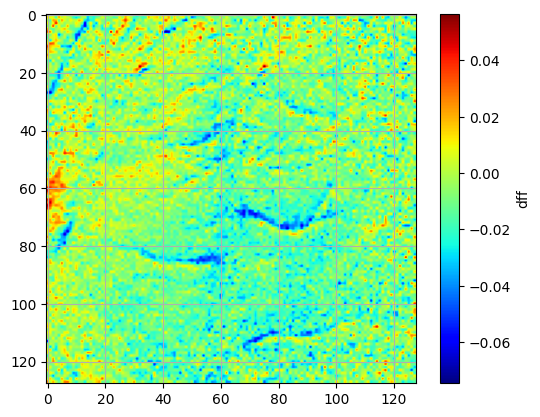

In [23]:
#plot of spatial signal without spatial smoothing
non_smoothed = plot_frame(dff_signal, frame_number, cmap = "jet", color_label = "dff")

#### 6A.2: spatial smoothing applied (gaussian, 3 pixels)

  0%|                                                                                          | 0/128 [00:00<?, ?it/s]

  1%|▋                                                                                 | 1/128 [00:00<00:37,  3.36it/s]

  2%|█▎                                                                                | 2/128 [00:00<00:33,  3.71it/s]

  2%|█▉                                                                                | 3/128 [00:00<00:34,  3.65it/s]

  3%|██▌                                                                               | 4/128 [00:01<00:34,  3.62it/s]

  4%|███▏                                                                              | 5/128 [00:01<00:34,  3.53it/s]

  5%|███▊                                                                              | 6/128 [00:01<00:34,  3.56it/s]

  5%|████▍                                                                             | 7/128 [00:01<00:34,  3.55it/s]

  6%|█████▏                                                                            | 8/128 [00:02<00:35,  3.35it/s]

  7%|█████▊                                                                            | 9/128 [00:02<00:34,  3.45it/s]

  8%|██████▎                                                                          | 10/128 [00:02<00:35,  3.36it/s]

  9%|██████▉                                                                          | 11/128 [00:03<00:34,  3.43it/s]

  9%|███████▌                                                                         | 12/128 [00:03<00:33,  3.51it/s]

 10%|████████▏                                                                        | 13/128 [00:03<00:31,  3.62it/s]

 11%|████████▊                                                                        | 14/128 [00:03<00:31,  3.59it/s]

 12%|█████████▍                                                                       | 15/128 [00:04<00:31,  3.64it/s]

 12%|██████████▏                                                                      | 16/128 [00:04<00:33,  3.36it/s]

 13%|██████████▊                                                                      | 17/128 [00:04<00:32,  3.43it/s]

 14%|███████████▍                                                                     | 18/128 [00:05<00:31,  3.47it/s]

 15%|████████████                                                                     | 19/128 [00:05<00:31,  3.41it/s]

 16%|████████████▋                                                                    | 20/128 [00:05<00:32,  3.32it/s]

 16%|█████████████▎                                                                   | 21/128 [00:06<00:32,  3.29it/s]

 17%|█████████████▉                                                                   | 22/128 [00:06<00:31,  3.35it/s]

 18%|██████████████▌                                                                  | 23/128 [00:06<00:31,  3.38it/s]

 19%|███████████████▏                                                                 | 24/128 [00:06<00:31,  3.27it/s]

 20%|███████████████▊                                                                 | 25/128 [00:07<00:31,  3.23it/s]

 20%|████████████████▍                                                                | 26/128 [00:07<00:30,  3.33it/s]

 21%|█████████████████                                                                | 27/128 [00:07<00:31,  3.25it/s]

 22%|█████████████████▋                                                               | 28/128 [00:08<00:29,  3.34it/s]

 23%|██████████████████▎                                                              | 29/128 [00:08<00:30,  3.29it/s]

 23%|██████████████████▉                                                              | 30/128 [00:08<00:29,  3.37it/s]

 24%|███████████████████▌                                                             | 31/128 [00:09<00:29,  3.27it/s]

 25%|████████████████████▎                                                            | 32/128 [00:09<00:29,  3.23it/s]

 26%|████████████████████▉                                                            | 33/128 [00:09<00:28,  3.35it/s]

 27%|█████████████████████▌                                                           | 34/128 [00:09<00:27,  3.45it/s]

 27%|██████████████████████▏                                                          | 35/128 [00:10<00:26,  3.51it/s]

 28%|██████████████████████▊                                                          | 36/128 [00:10<00:25,  3.64it/s]

 29%|███████████████████████▍                                                         | 37/128 [00:10<00:24,  3.64it/s]

 30%|████████████████████████                                                         | 38/128 [00:11<00:24,  3.66it/s]

 30%|████████████████████████▋                                                        | 39/128 [00:11<00:23,  3.71it/s]

 31%|█████████████████████████▎                                                       | 40/128 [00:11<00:25,  3.49it/s]

 32%|█████████████████████████▉                                                       | 41/128 [00:11<00:24,  3.49it/s]

 33%|██████████████████████████▌                                                      | 42/128 [00:12<00:24,  3.52it/s]

 34%|███████████████████████████▏                                                     | 43/128 [00:12<00:23,  3.64it/s]

 34%|███████████████████████████▊                                                     | 44/128 [00:12<00:22,  3.75it/s]

 35%|████████████████████████████▍                                                    | 45/128 [00:12<00:22,  3.63it/s]

 36%|█████████████████████████████                                                    | 46/128 [00:13<00:23,  3.53it/s]

 37%|█████████████████████████████▋                                                   | 47/128 [00:13<00:23,  3.41it/s]

 38%|██████████████████████████████▍                                                  | 48/128 [00:13<00:25,  3.15it/s]

 38%|███████████████████████████████                                                  | 49/128 [00:14<00:26,  2.95it/s]

 39%|███████████████████████████████▋                                                 | 50/128 [00:14<00:26,  2.92it/s]

 40%|████████████████████████████████▎                                                | 51/128 [00:15<00:25,  2.97it/s]

 41%|████████████████████████████████▉                                                | 52/128 [00:15<00:25,  3.02it/s]

 41%|█████████████████████████████████▌                                               | 53/128 [00:15<00:24,  3.06it/s]

 42%|██████████████████████████████████▏                                              | 54/128 [00:16<00:25,  2.90it/s]

 43%|██████████████████████████████████▊                                              | 55/128 [00:16<00:25,  2.87it/s]

 44%|███████████████████████████████████▍                                             | 56/128 [00:16<00:25,  2.82it/s]

 45%|████████████████████████████████████                                             | 57/128 [00:17<00:25,  2.84it/s]

 45%|████████████████████████████████████▋                                            | 58/128 [00:17<00:23,  2.96it/s]

 46%|█████████████████████████████████████▎                                           | 59/128 [00:17<00:22,  3.01it/s]

 47%|█████████████████████████████████████▉                                           | 60/128 [00:18<00:22,  3.01it/s]

 48%|██████████████████████████████████████▌                                          | 61/128 [00:18<00:22,  3.03it/s]

 48%|███████████████████████████████████████▏                                         | 62/128 [00:18<00:21,  3.07it/s]

 49%|███████████████████████████████████████▊                                         | 63/128 [00:19<00:20,  3.14it/s]

 50%|████████████████████████████████████████▌                                        | 64/128 [00:19<00:21,  3.03it/s]

 51%|█████████████████████████████████████████▏                                       | 65/128 [00:19<00:20,  3.07it/s]

 52%|█████████████████████████████████████████▊                                       | 66/128 [00:20<00:19,  3.16it/s]

 52%|██████████████████████████████████████████▍                                      | 67/128 [00:20<00:18,  3.29it/s]

 53%|███████████████████████████████████████████                                      | 68/128 [00:20<00:18,  3.33it/s]

 54%|███████████████████████████████████████████▋                                     | 69/128 [00:20<00:17,  3.37it/s]

 55%|████████████████████████████████████████████▎                                    | 70/128 [00:21<00:16,  3.50it/s]

 55%|████████████████████████████████████████████▉                                    | 71/128 [00:21<00:15,  3.58it/s]

 56%|█████████████████████████████████████████████▌                                   | 72/128 [00:21<00:16,  3.36it/s]

 57%|██████████████████████████████████████████████▏                                  | 73/128 [00:22<00:16,  3.36it/s]

 58%|██████████████████████████████████████████████▊                                  | 74/128 [00:22<00:15,  3.38it/s]

 59%|███████████████████████████████████████████████▍                                 | 75/128 [00:22<00:15,  3.35it/s]

 59%|████████████████████████████████████████████████                                 | 76/128 [00:22<00:15,  3.43it/s]

 60%|████████████████████████████████████████████████▋                                | 77/128 [00:23<00:14,  3.49it/s]

 61%|█████████████████████████████████████████████████▎                               | 78/128 [00:23<00:14,  3.47it/s]

 62%|█████████████████████████████████████████████████▉                               | 79/128 [00:23<00:14,  3.45it/s]

 62%|██████████████████████████████████████████████████▋                              | 80/128 [00:24<00:14,  3.37it/s]

 63%|███████████████████████████████████████████████████▎                             | 81/128 [00:24<00:13,  3.49it/s]

 64%|███████████████████████████████████████████████████▉                             | 82/128 [00:24<00:12,  3.62it/s]

 65%|████████████████████████████████████████████████████▌                            | 83/128 [00:24<00:12,  3.70it/s]

 66%|█████████████████████████████████████████████████████▏                           | 84/128 [00:25<00:11,  3.75it/s]

 66%|█████████████████████████████████████████████████████▊                           | 85/128 [00:25<00:11,  3.64it/s]

 67%|██████████████████████████████████████████████████████▍                          | 86/128 [00:25<00:11,  3.61it/s]

 68%|███████████████████████████████████████████████████████                          | 87/128 [00:25<00:11,  3.62it/s]

 69%|███████████████████████████████████████████████████████▋                         | 88/128 [00:26<00:11,  3.44it/s]

 70%|████████████████████████████████████████████████████████▎                        | 89/128 [00:26<00:11,  3.33it/s]

 70%|████████████████████████████████████████████████████████▉                        | 90/128 [00:26<00:11,  3.36it/s]

 71%|█████████████████████████████████████████████████████████▌                       | 91/128 [00:27<00:11,  3.26it/s]

 72%|██████████████████████████████████████████████████████████▏                      | 92/128 [00:27<00:11,  3.11it/s]

 73%|██████████████████████████████████████████████████████████▊                      | 93/128 [00:27<00:11,  3.16it/s]

 73%|███████████████████████████████████████████████████████████▍                     | 94/128 [00:28<00:10,  3.22it/s]

 74%|████████████████████████████████████████████████████████████                     | 95/128 [00:28<00:09,  3.32it/s]

 75%|████████████████████████████████████████████████████████████▊                    | 96/128 [00:28<00:09,  3.22it/s]

 76%|█████████████████████████████████████████████████████████████▍                   | 97/128 [00:29<00:09,  3.37it/s]

 77%|██████████████████████████████████████████████████████████████                   | 98/128 [00:29<00:08,  3.45it/s]

 77%|██████████████████████████████████████████████████████████████▋                  | 99/128 [00:29<00:08,  3.49it/s]

 78%|██████████████████████████████████████████████████████████████▌                 | 100/128 [00:29<00:08,  3.42it/s]

 79%|███████████████████████████████████████████████████████████████▏                | 101/128 [00:30<00:07,  3.56it/s]

 80%|███████████████████████████████████████████████████████████████▊                | 102/128 [00:30<00:07,  3.61it/s]

 80%|████████████████████████████████████████████████████████████████▍               | 103/128 [00:30<00:06,  3.59it/s]

 81%|█████████████████████████████████████████████████████████████████               | 104/128 [00:31<00:07,  3.34it/s]

 82%|█████████████████████████████████████████████████████████████████▋              | 105/128 [00:31<00:06,  3.33it/s]

 83%|██████████████████████████████████████████████████████████████████▎             | 106/128 [00:31<00:06,  3.41it/s]

 84%|██████████████████████████████████████████████████████████████████▉             | 107/128 [00:31<00:06,  3.47it/s]

 84%|███████████████████████████████████████████████████████████████████▌            | 108/128 [00:32<00:05,  3.38it/s]

 85%|████████████████████████████████████████████████████████████████████▏           | 109/128 [00:32<00:05,  3.41it/s]

 86%|████████████████████████████████████████████████████████████████████▊           | 110/128 [00:32<00:05,  3.41it/s]

 87%|█████████████████████████████████████████████████████████████████████▍          | 111/128 [00:33<00:05,  3.38it/s]

 88%|██████████████████████████████████████████████████████████████████████          | 112/128 [00:33<00:04,  3.21it/s]

 88%|██████████████████████████████████████████████████████████████████████▋         | 113/128 [00:33<00:04,  3.29it/s]

 89%|███████████████████████████████████████████████████████████████████████▎        | 114/128 [00:34<00:04,  3.25it/s]

 90%|███████████████████████████████████████████████████████████████████████▉        | 115/128 [00:34<00:03,  3.35it/s]

 91%|████████████████████████████████████████████████████████████████████████▌       | 116/128 [00:34<00:03,  3.32it/s]

 91%|█████████████████████████████████████████████████████████████████████████▏      | 117/128 [00:34<00:03,  3.31it/s]

 92%|█████████████████████████████████████████████████████████████████████████▊      | 118/128 [00:35<00:02,  3.43it/s]

 93%|██████████████████████████████████████████████████████████████████████████▍     | 119/128 [00:35<00:02,  3.52it/s]

 94%|███████████████████████████████████████████████████████████████████████████     | 120/128 [00:35<00:02,  3.35it/s]

 95%|███████████████████████████████████████████████████████████████████████████▋    | 121/128 [00:36<00:02,  3.33it/s]

 95%|████████████████████████████████████████████████████████████████████████████▎   | 122/128 [00:36<00:01,  3.43it/s]

 96%|████████████████████████████████████████████████████████████████████████████▉   | 123/128 [00:36<00:01,  3.57it/s]

 97%|█████████████████████████████████████████████████████████████████████████████▌  | 124/128 [00:36<00:01,  3.49it/s]

 98%|██████████████████████████████████████████████████████████████████████████████▏ | 125/128 [00:37<00:00,  3.61it/s]

 98%|██████████████████████████████████████████████████████████████████████████████▊ | 126/128 [00:37<00:00,  3.62it/s]

 99%|███████████████████████████████████████████████████████████████████████████████▍| 127/128 [00:37<00:00,  3.59it/s]

100%|████████████████████████████████████████████████████████████████████████████████| 128/128 [00:38<00:00,  3.63it/s]

100%|████████████████████████████████████████████████████████████████████████████████| 128/128 [00:38<00:00,  3.37it/s]

frame number 200 plotted


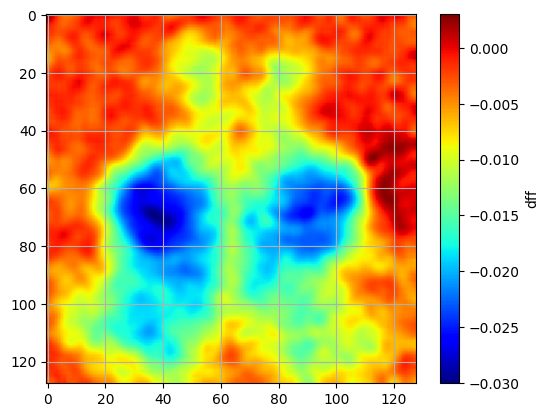

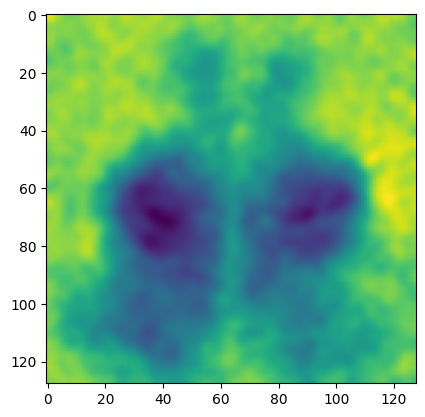

In [24]:
#plot of spatial resolution including spatial smoothing
smoothed_signal = smoothing(dff_signal)
plot_frame(smoothed_signal, 200, cmap = "jet", color_label = "dff")
plt.imshow(smoothed_signal[201])

### 6B: Temporal filtering

dff plot with chebyshev type 1 temporal filtering (high and low bandpass filter)

In [25]:
interactive_plot(smoothed_signal.mean(axis=(1,2)), title_label = "temporally smoothed signal", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

## Step 7: ROI plotting

### 7A: ROI full frame

plotting single flash full frame mean

In [26]:
full_roi_single, full_single_segments = avg_trials(single_indices, smoothed_signal, double=False, segment_size=200, minus=20)

In [27]:
interactive_plot(full_roi_single.mean(axis=(1,2)), title_label = "full frame single average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

plotting double flash full frame mean

In [28]:
full_roi_double, full_double_segments = avg_trials(double_indices, smoothed_signal, double=True, segment_size=200, minus=20)

In [29]:
interactive_plot(full_roi_double.mean(axis=(1,2)), title_label = "full frame double average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

plotting NOGO full frame mean

Need to import the text file to know the location of the nogo trials

In [30]:
txt_path = f"X:/RaymondLab/1_Kai/2_Pi_data/{cohort}/{cageID}/stage2_{cageID}_{mouseID}/lick_rates/{session}_data.txt"
txt_file = load_txt(txt_path, fps=30, footer = 4)

successfully loaded txt file


In [31]:
nogo_trials = extract_nogo(txt_file)

# nogo trials: 18


plotting nogo trials

In [32]:
full_roi_nogo, full_nogo_segments = avg_trials(nogo_trials, smoothed_signal, double=False, segment_size=200, minus=20)

In [33]:
interactive_plot(full_roi_nogo.mean(axis=(1,2)), title_label = "full frame NOGO average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

### 7B: V1 ROI

within all of v1 area at the back of the cortex the peak value at 5 frames is taken as the central point and a 15x15 grid is placed around the peak value

plotting single flash just v1 10x10 mean

In [34]:
v1_area_single = extract_v1(full_roi_single, roi_time = 5, roi_start_x=15, roi_start_y = 85, roi_width=45, roi_height = 45)

In [35]:
interactive_plot(v1_area_single.mean(axis=(1,2)), title_label = "v1 single average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

plotting double flash just v1 10x10 mean

In [36]:
v1_area_double = extract_v1(full_roi_double, roi_time = 5, roi_start_x=15, roi_start_y = 85, roi_width=45, roi_height = 45)

In [37]:
interactive_plot(v1_area_double.mean(axis=(1,2)), title_label = "v1 double average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

## Step 8: Line up to txt file and success vs fail rate

#### Step 8A: load in txt file from Pi_data folder

In [38]:
txt_path = f"X:/RaymondLab/1_Kai/2_Pi_data/{cohort}/{cageID}/stage2_{cageID}_{mouseID}/lick_rates/{session}_data.txt"
txt_file = load_txt(txt_path, fps=30, footer = 4)

#extract single, double or nogo columns from the txt file
single_txt, double_txt, nogo_txt = extract_success(txt_file)

successfully loaded txt file


#### Step 8B: take the dff signal and sort them into arrays based on success or fail

In [39]:
single_success, single_fail = sort_success(single_txt, full_single_segments)

success = 31
fail = 11
total trials = 42


In [40]:
double_success, double_fail = sort_success(double_txt, full_double_segments)

success = 30
fail = 10
total trials = 40


In [41]:
nogo_success, nogo_fail = sort_success(nogo_txt, full_nogo_segments)

success = 5
fail = 13
total trials = 18


## Step 9: Save the 3D array as a TIFF stack

In [42]:
save_tiff(smoothed_signal, tiff_path_full) # full frame whole session tiff stack
save_tiff(full_roi_single, tiff_path_single) #SINGLE flash averaged response over all trials tiff stack file name to save
save_tiff(full_roi_double, tiff_path_double) #DOUBLE flash averaged response over all trials tiff stack file name to save

  0%|                                                                                        | 0/34384 [00:00<?, ?it/s]

  7%|█████                                                                     | 2376/34384 [00:00<00:01, 23668.21it/s]

 14%|██████████▏                                                               | 4743/34384 [00:00<00:01, 22611.69it/s]

 22%|████████████████▎                                                         | 7569/34384 [00:00<00:01, 25017.03it/s]

 30%|██████████████████████                                                   | 10392/34384 [00:00<00:00, 26164.35it/s]

 38%|███████████████████████████▋                                             | 13014/34384 [00:00<00:00, 25551.48it/s]

 45%|█████████████████████████████████                                        | 15575/34384 [00:00<00:00, 24517.75it/s]

 53%|██████████████████████████████████████▍                                  | 18080/34384 [00:00<00:00, 24609.66it/s]

 61%|████████████████████████████████████████████▎                            | 20869/34384 [00:00<00:00, 25543.33it/s]

 68%|█████████████████████████████████████████████████▋                       | 23431/34384 [00:00<00:00, 24100.56it/s]

 76%|███████████████████████████████████████████████████████▎                 | 26032/34384 [00:01<00:00, 24587.05it/s]

 84%|█████████████████████████████████████████████████████████████            | 28745/34384 [00:01<00:00, 25260.62it/s]

 91%|██████████████████████████████████████████████████████████████████▍      | 31285/34384 [00:01<00:00, 25230.00it/s]

 99%|████████████████████████████████████████████████████████████████████████▎| 34044/34384 [00:01<00:00, 25853.63it/s]

100%|█████████████████████████████████████████████████████████████████████████| 34384/34384 [00:01<00:00, 25098.44it/s]

Combined TIFF stack saved successfully.


  0%|                                                                                          | 0/200 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 200/200 [00:00<00:00, 33346.35it/s]

Combined TIFF stack saved successfully.


  0%|                                                                                          | 0/200 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 200/200 [00:00<00:00, 11768.86it/s]

Combined TIFF stack saved successfully.


### Step 9B: Pickle for uploading into other scripts

In [43]:
# Now you can use these file paths in your code
with open(pickle_single_v1, 'wb') as f:
    pickle.dump(v1_area_single, f)

with open(pickle_double_v1, 'wb') as f:
    pickle.dump(v1_area_double, f)

with open(pickle_single_success_ff, 'wb') as f:
    pickle.dump(single_success, f)

with open(pickle_single_fail_ff, 'wb') as f:
    pickle.dump(single_fail, f)

with open(pickle_double_success_ff, 'wb') as f:
    pickle.dump(double_success, f)

with open(pickle_double_fail_ff, 'wb') as f:
    pickle.dump(double_fail, f)

with open(pickle_nogo_success_ff, 'wb') as f:
    pickle.dump(nogo_success, f)

with open(pickle_nogo_fail_ff, 'wb') as f:
    pickle.dump(nogo_fail, f)

# Mask and animate figures

#### currently not using these, good for visualization and flair

In [44]:
#masking = load_masks(dff_signal)
#mask, mask_outline = masking[0], masking[1]

#masked_smoothed_signal = smoothed_signal*mask
#masked_full_roi_single = full_roi_single*mask
#masked_full_roi_double = full_roi_double*mask

In [45]:
#file_path_ = "X:/Raymond Lab/Kaiiiii/processed_data/ #429904_m1_stage2_day2_with_spouts.tiff"
#save_tiff(masked_smoothed_signal, file_path)

#file_path = "X:/Raymond Lab/Kaiiiii/processed_data/ #429904_m1_stage2_day2_with_spouts_avg_single.tiff"
#save_tiff(masked_full_roi_single, file_path)

#file_path = "X:/Raymond Lab/Kaiiiii/processed_data/ #429904_m1_stage2_day2_with_spouts_avg_double.tiff"
#save_tiff(masked_full_roi_double, file_path)

#print(f"TIFF stack saved at: {file_path}")